In [12]:
import numpy as np
import torch
from sbi import utils as utils
from sbi.inference.base import infer
import matplotlib.pyplot as plt
from data_read import read_obs, read_indiv_obs
from analysis_utils import violin_plots, welch_ttest,glassdelta_effect_size, mse, marked_dist_plot
import sklearn
import scipy.io
from scipy.stats import ttest_ind
import pickle
import copy
import pandas as pd
import seaborn as sns
from sbi import analysis as analysis
import pandas as pd
import configparser
from model import Model

train = False

In [13]:
all_labels = ['Aud Delay',
          'Somat Delay',
          'Log_10 Aud Noise Var',
          'Noise Ratio (Aud:Somat)',
          'Controller Gain']

def simulator_no_noise(parameter_set):
    config = configparser.ConfigParser()
    config.read('pitch_pert_configs.ini')
    override_params(config,parameter_set)
    model = Model(config)
    y_output,errors = model.run()
    pitch_output = y_output[:,0,0]
    pitch_output[pitch_output < 50] = 50
    pitch_baseline = np.mean(pitch_output[0:50])
    pitch_output_cents = 1200 * np.log2(pitch_output/pitch_baseline)
    return pitch_output_cents

def override_params(config,parameter_set):
    config['Observer']['aud_fdbk_delay'] = str(parameter_set[0].item())
    config['Observer']['somat_fdbk_delay'] = str(parameter_set[1].item())
    config['Vocal_Tract']['aud_noise_covariance'] = str(10**parameter_set[2].item())
    config['Vocal_Tract']['somat_noise_covariance'] = str(10**parameter_set[2].item() / parameter_set[3].item())
    config['Controller']['controller_gain'] = str(parameter_set[4].item())

def simulator(parameter_set):
    training_noise_scale = 7
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

def compare(posterior, obs_list, n_samples,prior_min,prior_max,labels,fwer=0.05,fit_stde=False,name=None,xlabel=False):
    data_list=[]
    for observation in obs_list:
        np.random.seed(10)
        torch.manual_seed(10)
        samples = posterior.sample((n_samples,), x=observation.get('data'))
        log_probability = posterior.log_prob(samples, x=observation.get('data'))
        max_likelihood = samples[torch.argmax(log_probability)]
        print(max_likelihood)
        topk_likelihood = samples[torch.topk(log_probability,1000).indices]
        marked_dist_plot(samples, prior_min, prior_max, labels, max_likelihood=max_likelihood, actual_params=None, name=observation.get('name'))
        data = {'name': observation.get('name'),'color': observation.get('color'),'taxis':observation.get('taxis'),'samples':samples, 
                'max_likelihood': max_likelihood, 'topk_likelihood': topk_likelihood}
        data_list.append(data)
    sig_list = welch_ttest(data_list,fwer,len(labels))
    glass_delta_list = glassdelta_effect_size(data_list,len(labels),n_samples)
    plot_actual_data(obs_list)
    inferred_list = plot_actual_inferred_data(obs_list,data_list,name=name,xlabel=xlabel,ylabel=True,ylim=None)
    diff_list = np.ndarray((2,))
    diff_list[0] = mse(obs_list[0].get('data'),inferred_list[0,:])
    diff_list[1] = mse(obs_list[1].get('data'),inferred_list[1,:])
    print("MSE: " + str(diff_list))
    violin_plots(data_list,sig_list,glass_delta_list,prior_min,prior_max,labels,name)
    return data_list, diff_list
    
def plot_actual_data(obs_list,ax=None,xlabel=False,ylabel=False,ylim=[-5,45],legend=False,show_pert=False):
    if ax is None:
        fig, ax = plt.subplots()
    if show_pert:
        ax.axvspan(0,0.4,alpha=0.2,color='gray')
        ax.annotate('Perturbation',(0.01,40),fontsize=12,color='gray')
    for i, obs in enumerate(obs_list):
        ax.plot(obs.get('taxis'),obs.get('data'),label=obs.get('name'),linewidth=5,linestyle=':',color=obs.get('color'),alpha=0.5)
        ax.plot(obs.get('taxis'),obs.get('data')+obs.get('stde'),linewidth=2,linestyle=':',color=obs.get('color'))
        ax.plot(obs.get('taxis'),obs.get('data')-obs.get('stde'),linewidth=2,linestyle=':',color=obs.get('color'))
        #plt.fill_between(obs.get('taxis'),
        #             obs.get('data')+obs.get('stde'),
        #             obs.get('data')-obs.get('stde'),
        #             linewidth=5,color='#A3A3A3')
        if xlabel:
            ax.set_xlabel('Time (s)',fontsize=15)
            ax.tick_params(axis='x',which='major',labelsize=14)
        else: ax.set_xticks([])
        if ylabel:
            ax.set_ylabel('Pitch (cents)',fontsize=15)
            ax.tick_params(axis='y',which='major',labelsize=14)
        else: ax.set_yticks([])
        if ylim is not None:
            ax.set_ylim(ylim)
        if legend:
            ax.annotate(obs.get('name'), (0.7, 40-4*i), fontsize=15, color=obs.get('color'))
                     
def plot_actual_inferred_data(obs_list,data_list,ax=None,name=None,xlabel=False,ylabel=False,ylim=[-5,45],obs_to_plot=None,color=None,legend=True):
    ntrials = 1000
    inferred_list = np.ndarray((len(obs_list),len(obs_list[0].get('data'))))
    #plt.figure(figsize=(5,4))
    if ax is None:
        fig, ax = plt.subplots()
    if len(obs_list) < 5:
        plot_actual_data(obs_list,ax,xlabel,ylabel,ylim)
        for i, data in enumerate(data_list):
            #topk_likelihood = data.get('topk_likelihood')
            #ntrials = topk_likelihood.shape[0]
            if color is None: plot_color = data.get('color')
            else: plot_color = color
            taxis = obs_list[0].get('taxis')
            inferred_all = np.ndarray((ntrials,len(taxis)))
            for j in range(ntrials):
                #params = topk_likelihood[j,:]
                inferred_all[j,:] = simulator_no_noise(data.get('max_likelihood'))
                #inferred_all[j,:] = simulator_no_noise(params)
            inferred = np.median(inferred_all,axis=0)
            stde = np.std(inferred_all,axis=0) / np.sqrt(ntrials)
            inferred_list[i,:] = inferred
            if obs_to_plot is None or i in obs_to_plot:
                ax.plot(taxis,inferred,label=data.get('name')+' inferred',linewidth=5,color=plot_color)
                ax.plot(taxis,inferred-stde, linewidth=2,color=plot_color)
                ax.plot(taxis,inferred+stde, linewidth=2, color=plot_color)
    else: 
        for x in range(len(obs_list)):
            plot_actual_inferred_data([obs_list[x]],[data_list[x]],name=name,xlabel=xlabel)
    return inferred_list

def run_sbi(filename,nreps,prior_min_all,prior_max_all,all_labels,train=True,ablate=None):
    mse_sub = np.ndarray([2,nreps])
    labels = copy.deepcopy(all_labels)
    prior_min = copy.deepcopy(prior_min_all)
    prior_max = copy.deepcopy(prior_max_all)
    if ablate is not None:
        labels.pop(ablate)
        prior_min.pop(ablate)
        prior_max.pop(ablate)
    inferred_control_values_all = np.ndarray([len(labels),n_reps])
    for s in range(nreps):
        seed = (s+1) * 100
        if train:
            prior = utils.torchutils.BoxUniform(low=torch.as_tensor(prior_min), high=torch.as_tensor(prior_max))
            np.random.seed(seed)
            torch.manual_seed(seed)
            posterior = infer(simulator,prior, method='SNPE', num_simulations=n_simulations)
            posterior_save = {'prior_min':prior_min,'prior_max':prior_max,'posterior':posterior,'seed':seed}
            with open('posterior/'+ filename + '_seed' + str(seed) + '.pkl', "wb") as handle:
                pickle.dump(posterior_save,handle)
        np.random.seed(seed)
        torch.manual_seed(seed)
        with open('posterior/'+ filename + '_seed' + str(seed) + '.pkl', 'rb') as handle:
            posterior_dict = pickle.load(handle)
        posterior_new = posterior_dict.get('posterior')
        prior_min = posterior_dict.get('prior_min')
        prior_max = posterior_dict.get('prior_max')
        data_list,mse_sub[:,s] = compare(posterior_new,list(observation_dict.get('CA').values()),n_samples,prior_min,prior_max,labels,fit_stde=False,name='CA',xlabel=True)
        inferred_control_values_all[:,s] = data_list[0].get('max_likelihood')
    return data_list,inferred_control_values_all,mse_sub    

In [14]:
observation_dict = {}
    
observation_dict['CA'] = {'Controls': read_obs('pitch_pert_data/CA_Data/','CA','jh','control',"#E3787B"), 
                          'Patients': read_obs('pitch_pert_data/CA_Data/','CA','jh','patient',"#FFD166")}

C:\Users\jgaines\Anaconda3\envs\pitch_model_env\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


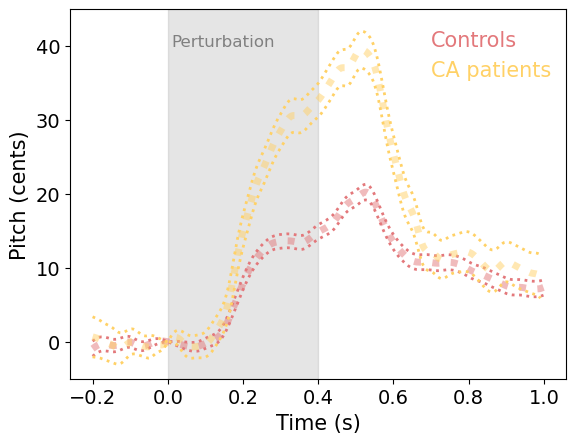

In [15]:
plot_actual_data(observation_dict.get('CA').values(),xlabel='Time (s)',ylabel='Pitch (cents)',legend=True,show_pert=True)

In [16]:
n_simulations = 100000
n_samples = 10000
n_reps = 10
mse_vals = np.ndarray([4,2,n_reps])

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([114.9612,  23.9758,  -9.6383,   2.2197,   2.0996])


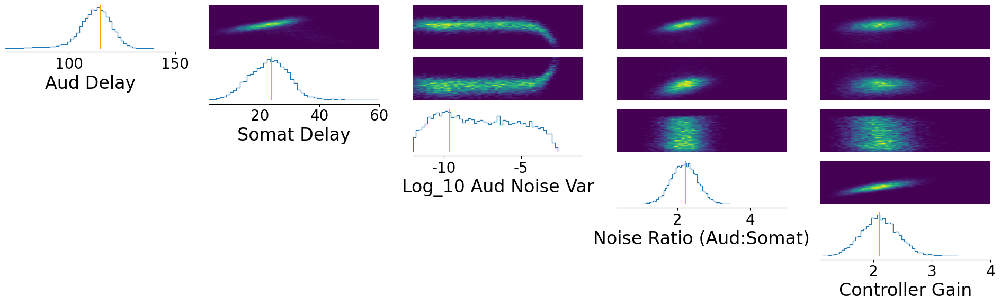

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.4320, 12.6655, -3.4976,  1.1569,  3.1429])


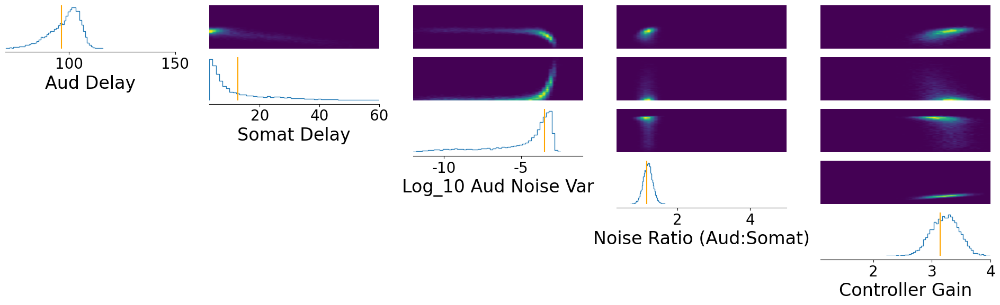

MSE: [0.53801437 4.36906836]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.7542,  16.5623,  -6.9851,   1.8710,   1.9621])


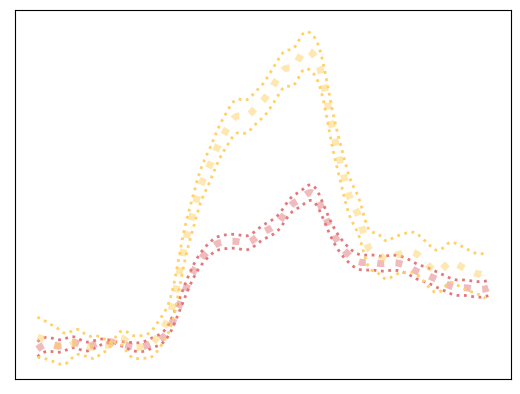

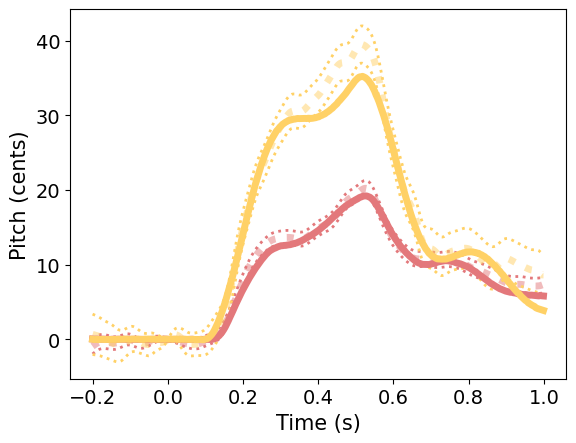

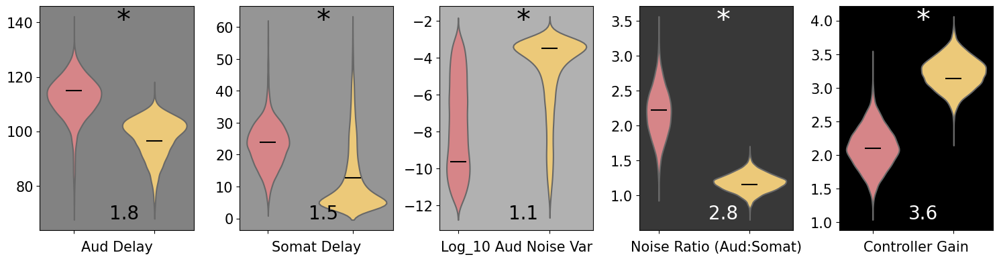

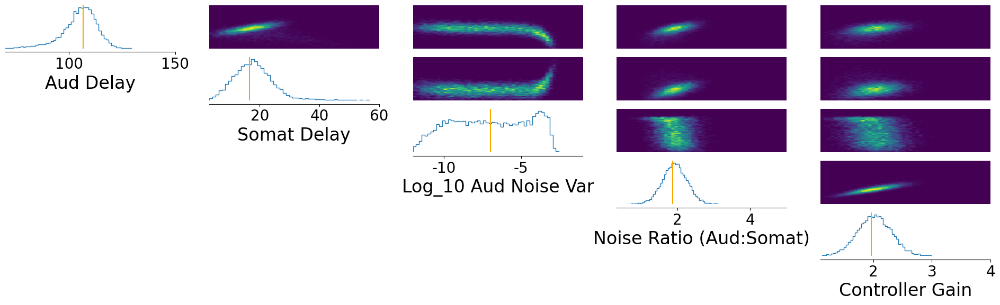

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([80.7357, 16.3121, -3.2475,  0.9323,  2.9644])


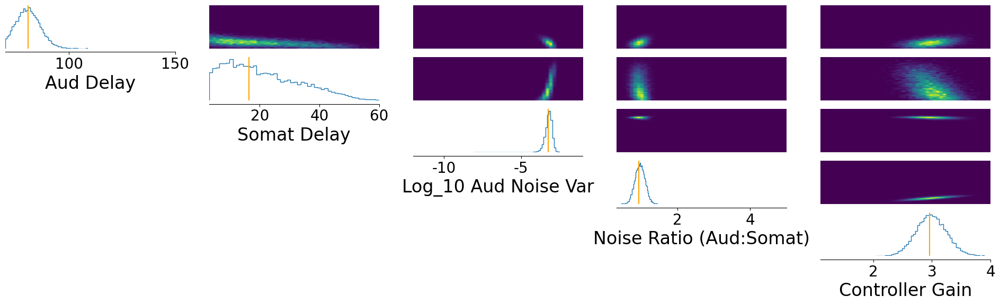

MSE: [0.50126029 2.79651881]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.1980,  26.3179,  -4.2467,   1.8604,   1.8417])


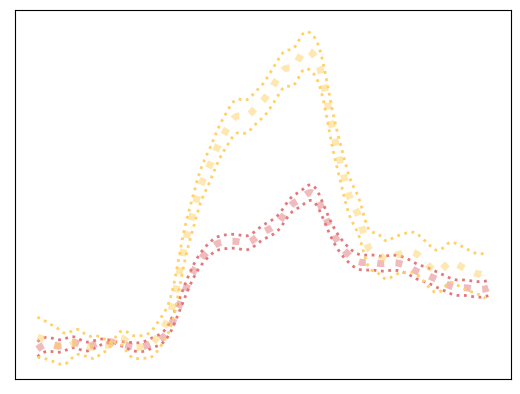

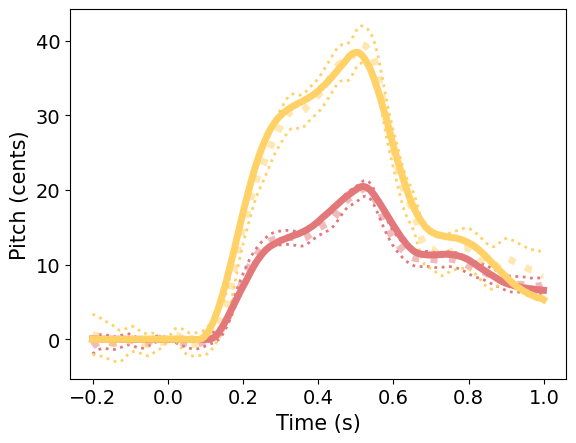

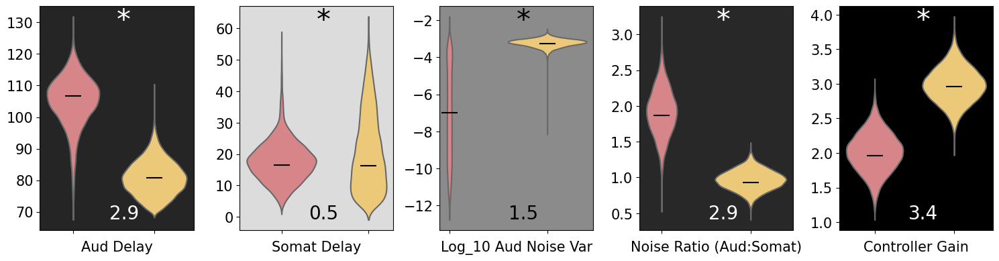

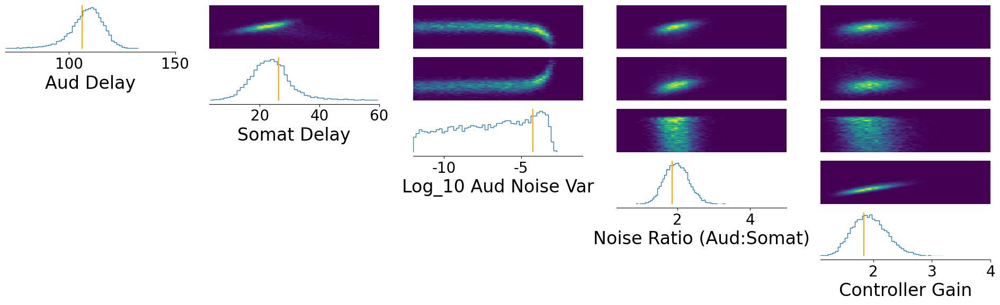

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([92.4608, 10.3841, -3.3627,  1.1236,  3.3096])


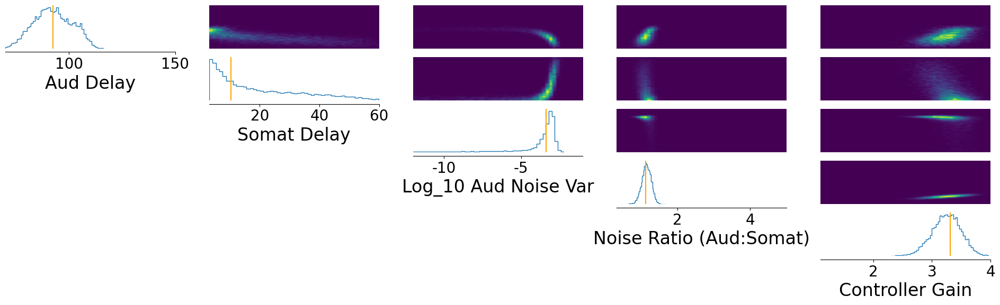

MSE: [0.3983006  3.32603714]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.9923,  20.7894,  -9.1602,   1.9975,   2.1213])


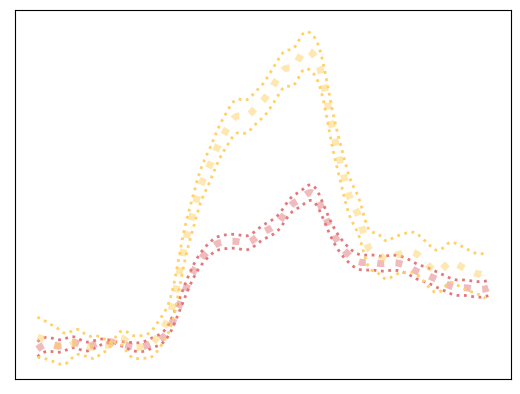

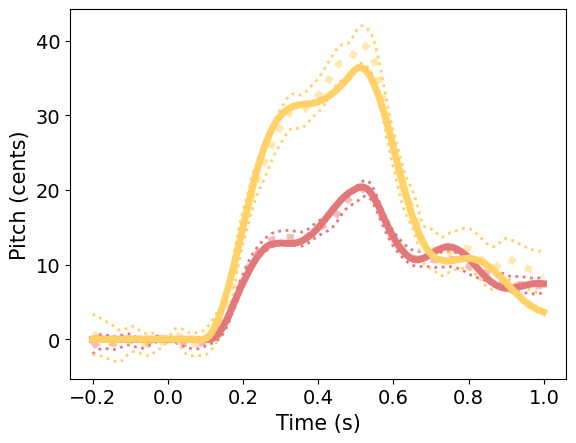

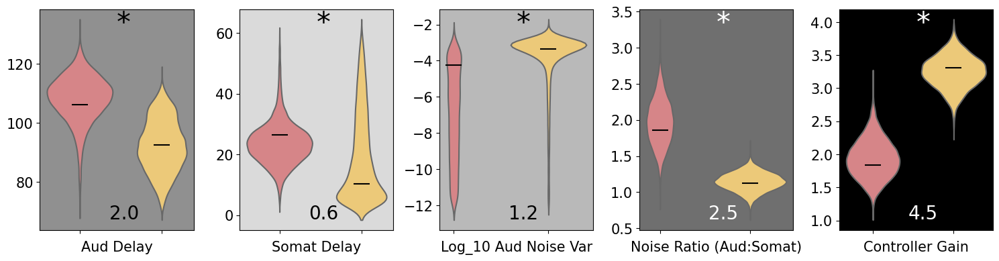

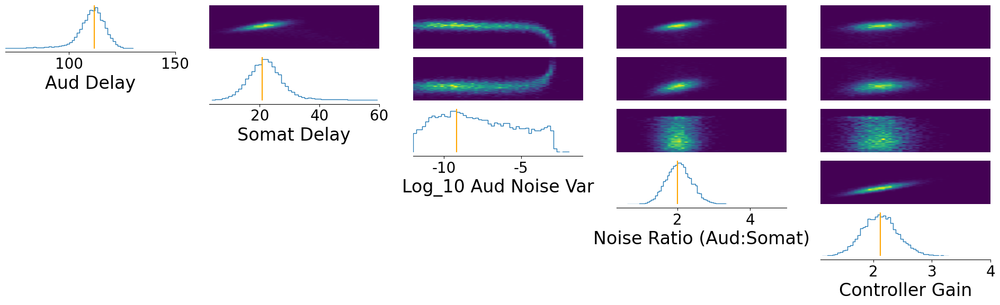

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([90.6937,  9.8329, -3.3961,  1.0261,  3.1445])


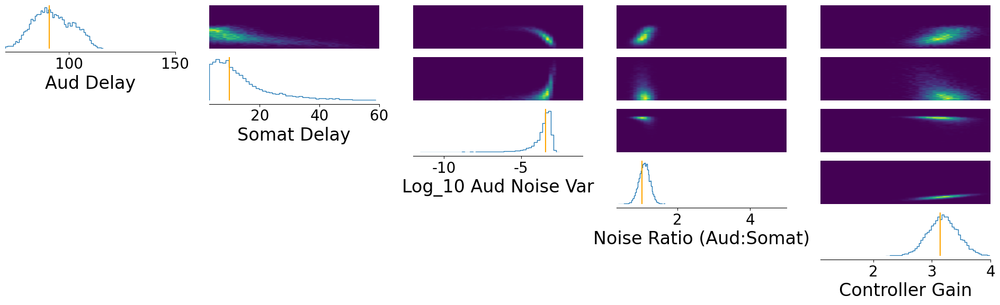

MSE: [0.4936061  2.28684938]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([114.9869,  22.9477,  -5.7745,   1.8513,   1.9731])


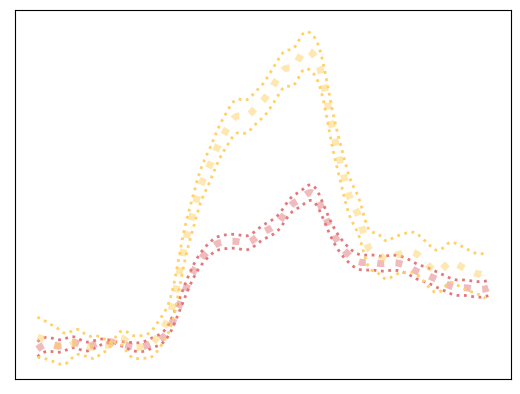

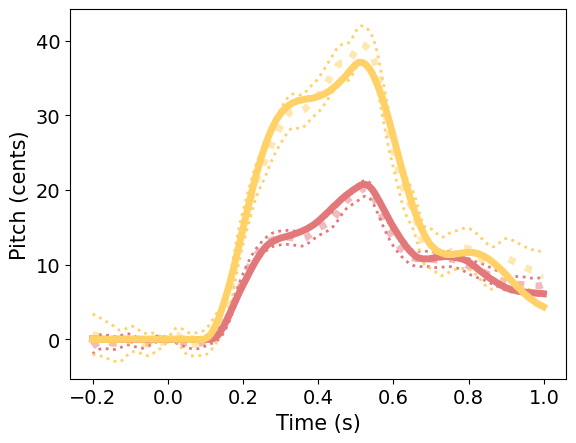

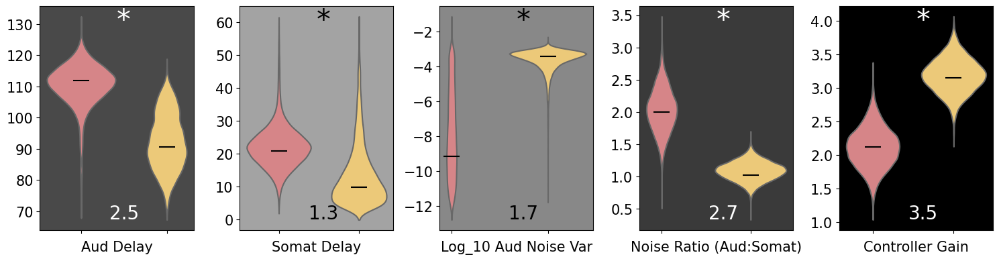

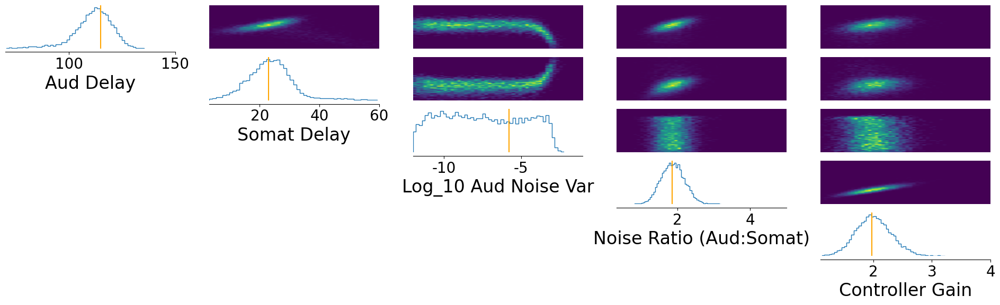

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([89.0397, 20.0553, -3.1314,  0.9363,  2.8370])


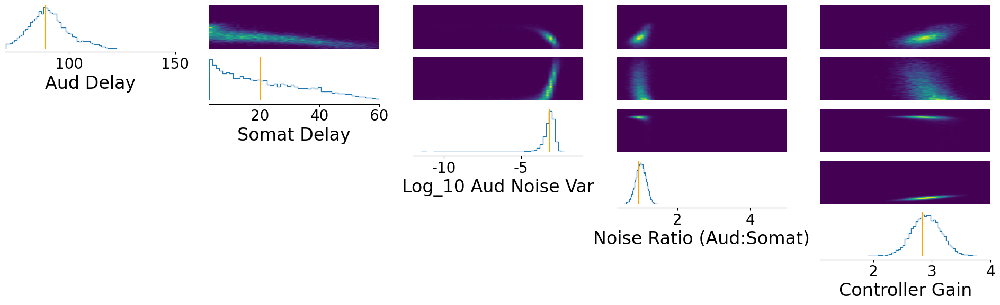

MSE: [0.68190269 2.2614795 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([109.1520,  22.4395,  -9.1234,   1.8205,   1.9781])


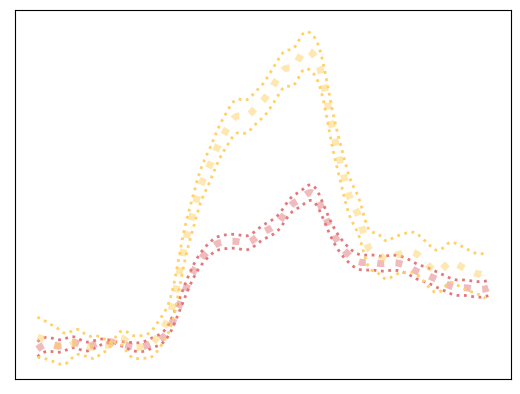

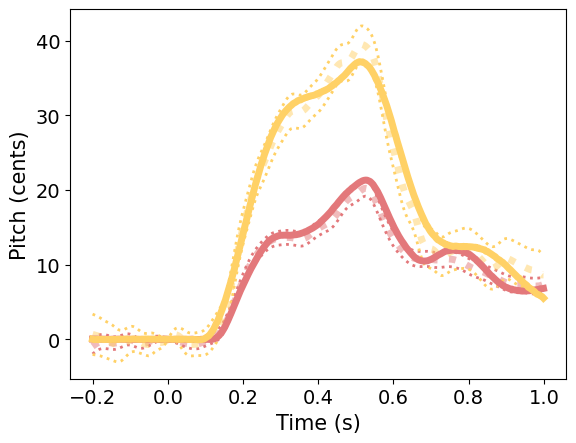

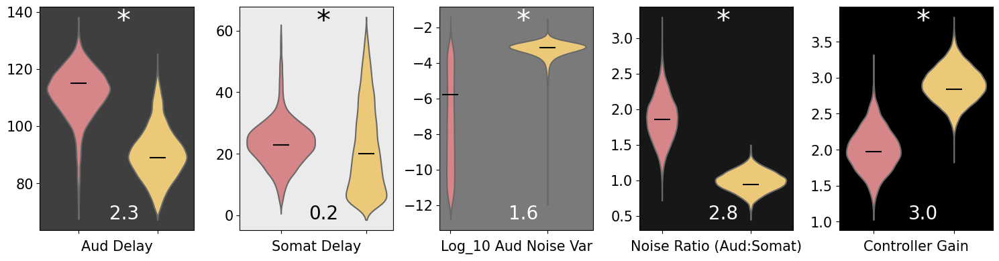

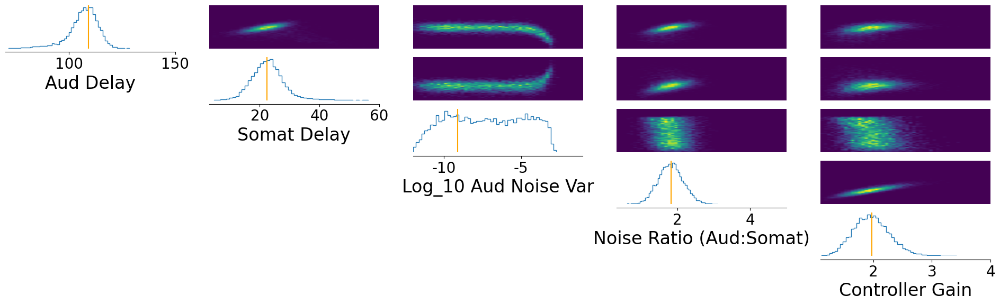

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([78.9426, 19.1818, -3.0672,  0.7960,  2.7747])


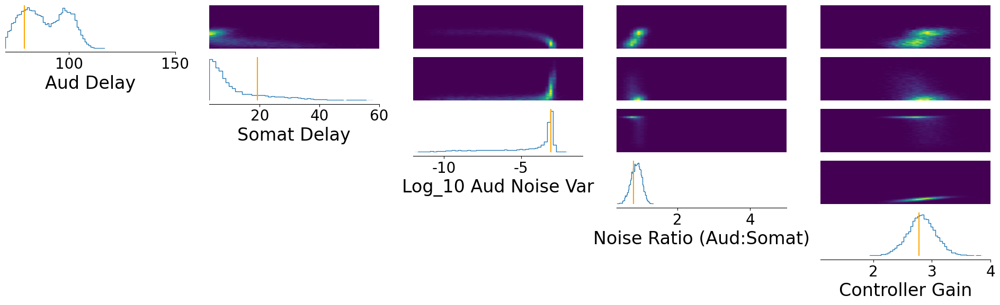

MSE: [0.80471772 4.7844106 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.5025,  23.5388,  -6.2984,   2.0422,   2.0742])


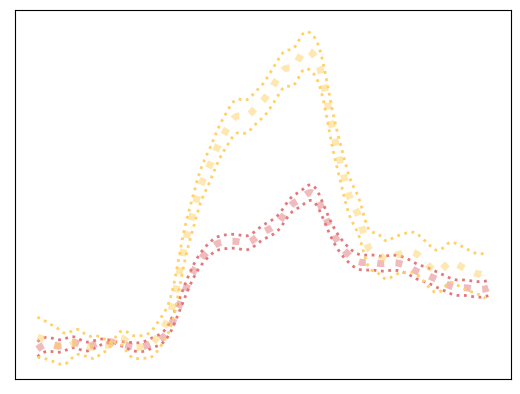

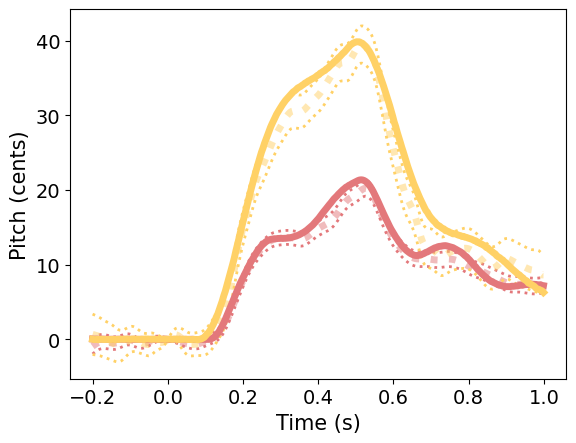

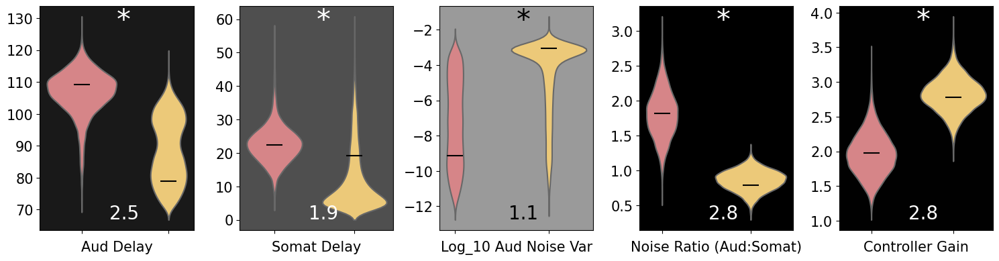

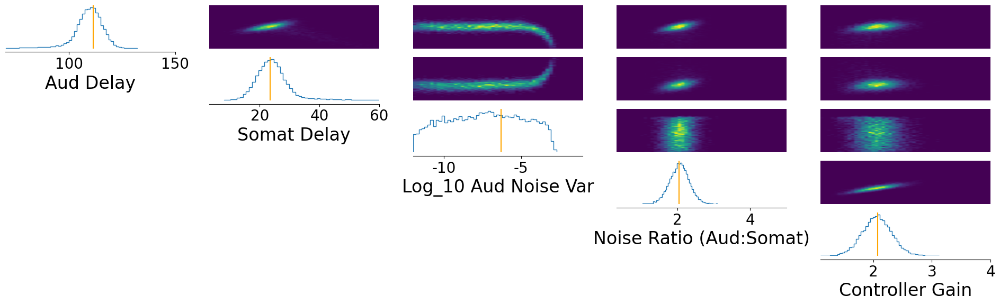

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.9578,  3.6779, -4.4762,  1.2295,  3.3341])


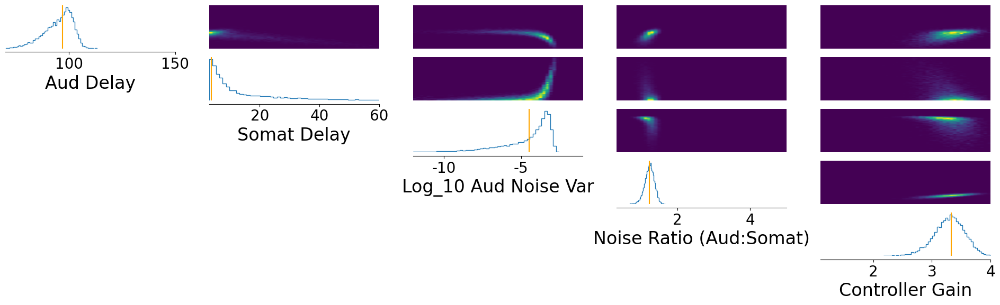

MSE: [0.30373197 8.33491717]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.1799,  24.4799, -10.4426,   1.9118,   1.8417])


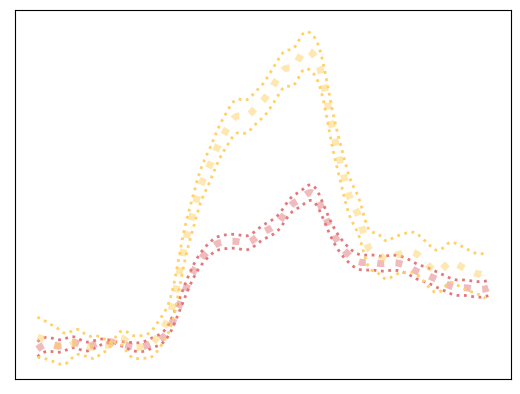

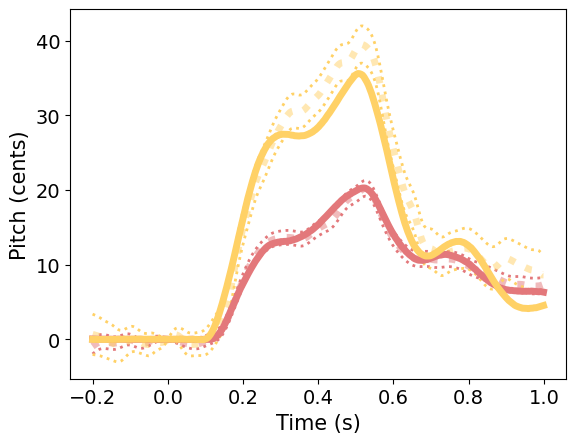

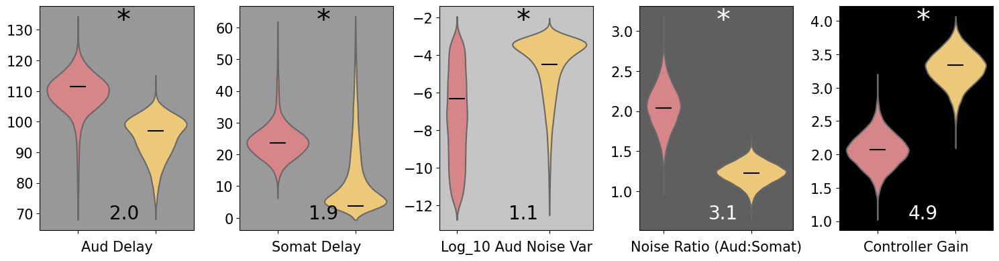

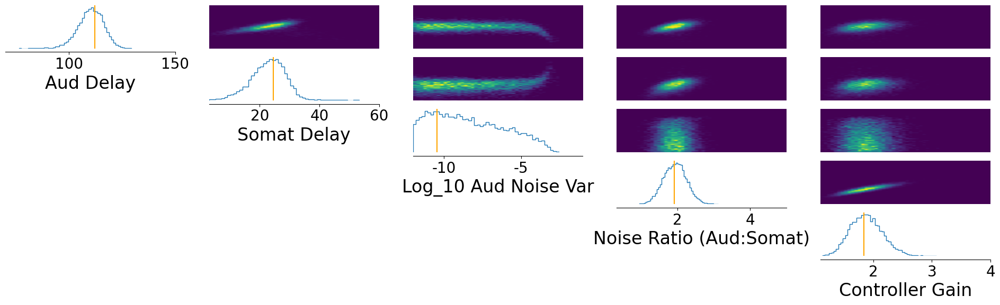

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.5256, 18.7746, -3.2146,  1.0005,  2.9122])


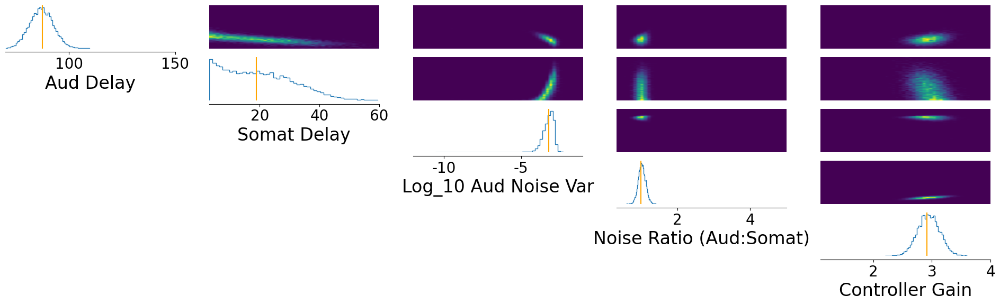

MSE: [0.31295972 2.22369925]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([113.2774,  24.4129,  -9.8054,   1.9289,   2.0117])


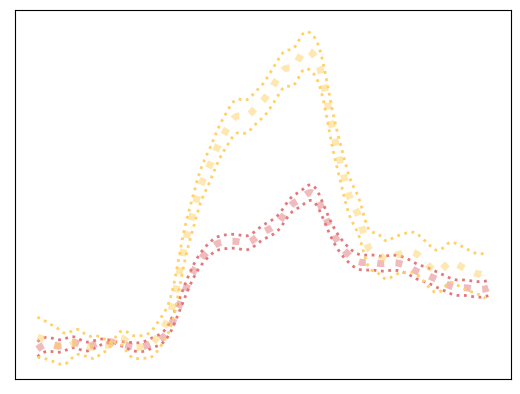

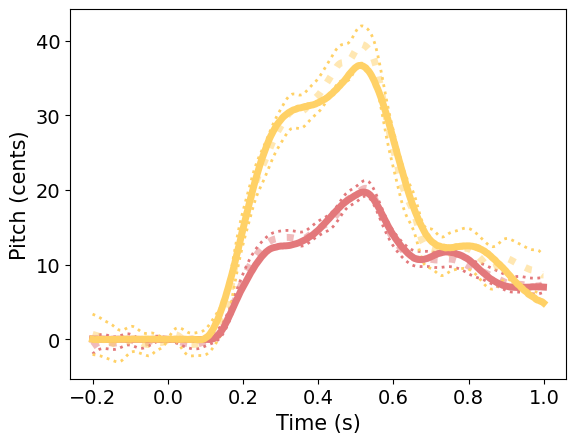

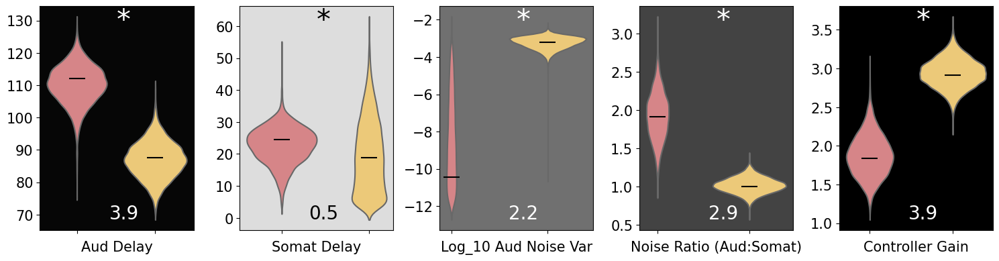

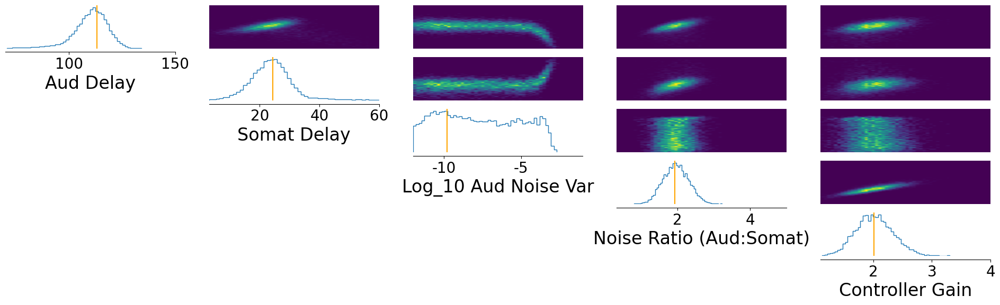

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([90.6804, 11.9201, -3.5301,  0.9719,  2.9833])


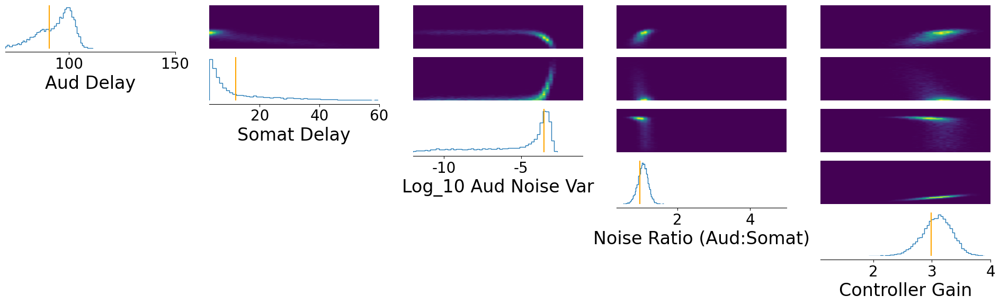

MSE: [0.39706836 3.03877747]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([117.1508,  24.3608,  -8.4270,   2.1081,   2.1045])


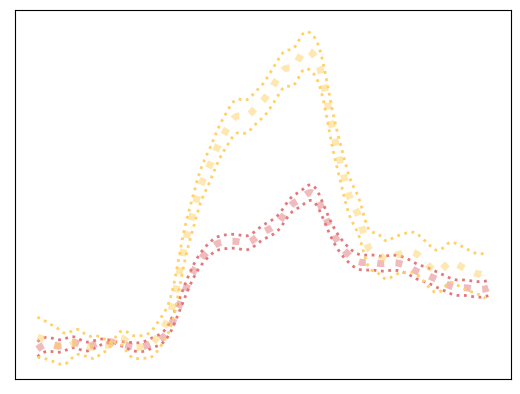

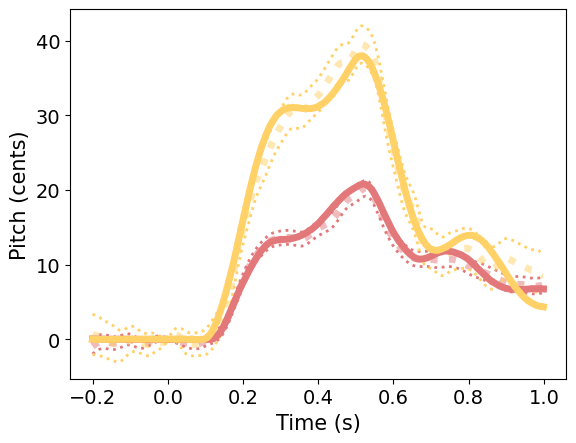

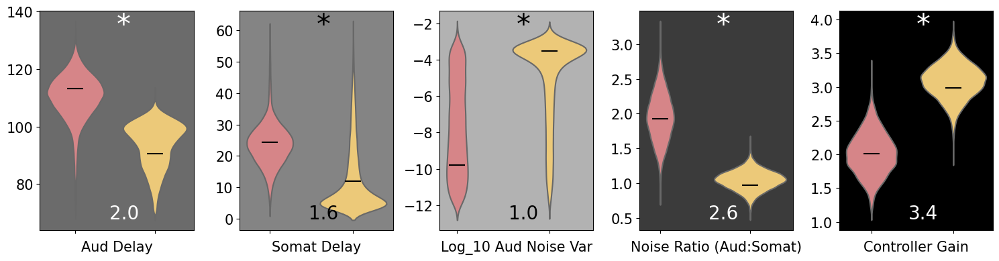

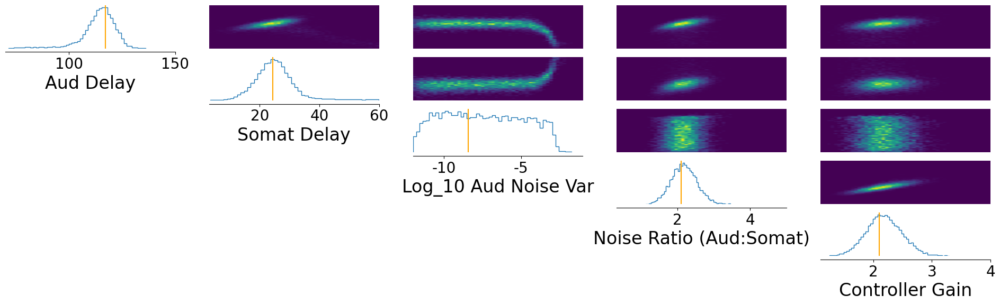

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.5769, 31.4952, -3.0424,  1.0915,  3.0168])


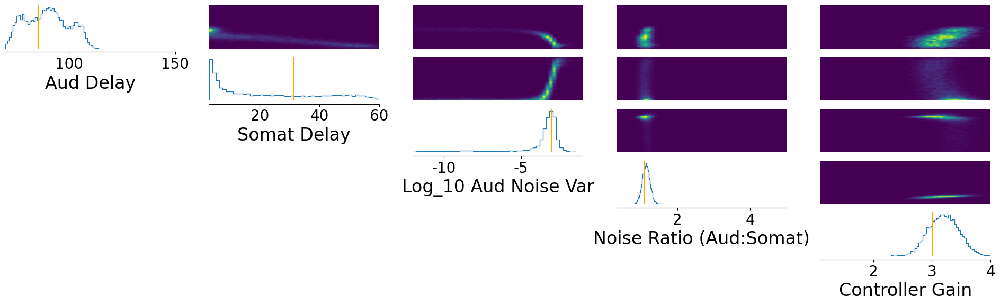

MSE: [0.35326911 3.03718406]


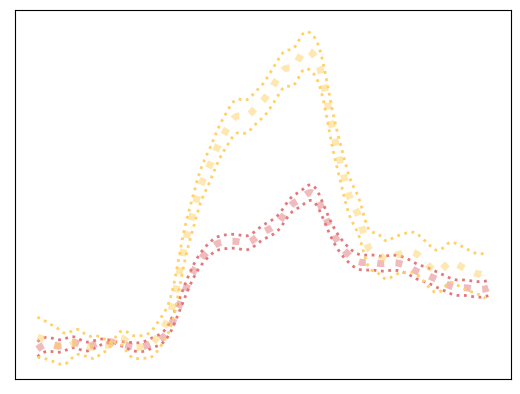

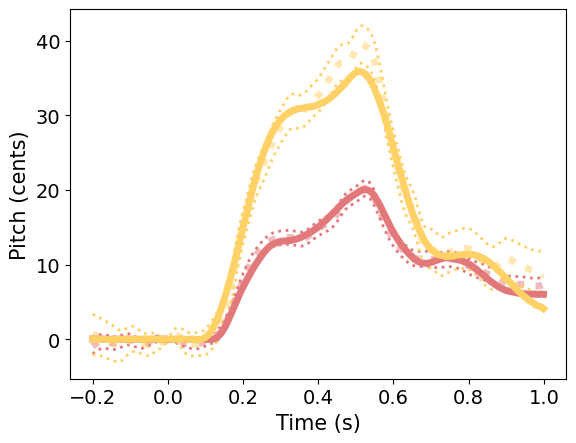

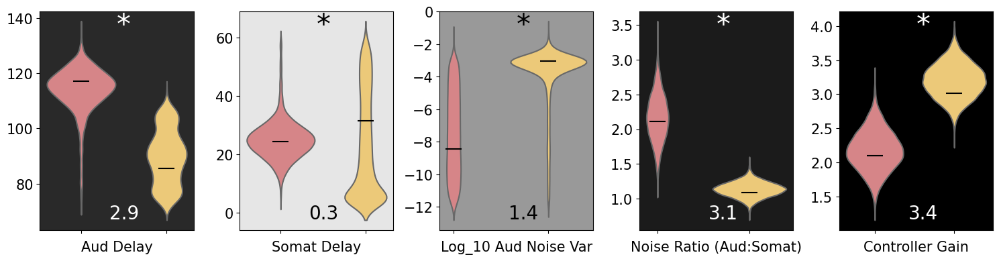

In [17]:
def simulator(parameter_set):
    training_noise_scale = 3
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

prior_min_all = [70, 3, -12, 0.3333, 1.1]
prior_max_all = [150, 60, -1, 5, 4]
data_list,inferred_control_values_all, mse_vals[0,:,:] = run_sbi('training_noise_3',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([109.5038,  21.1728,  -4.8332,   1.7665,   1.8688])


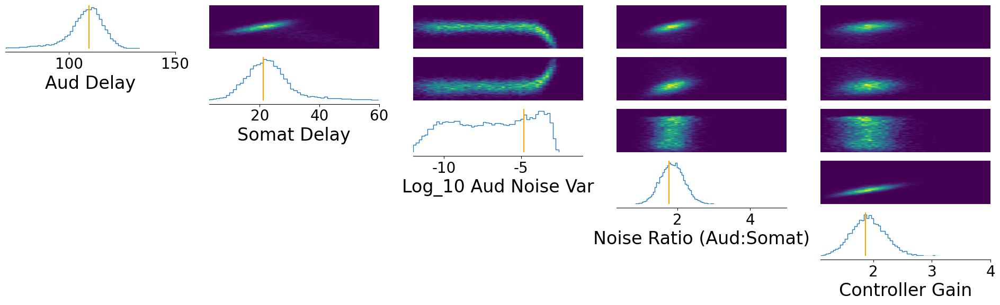

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.3790, 28.2294, -3.1358,  0.9949,  2.7571])


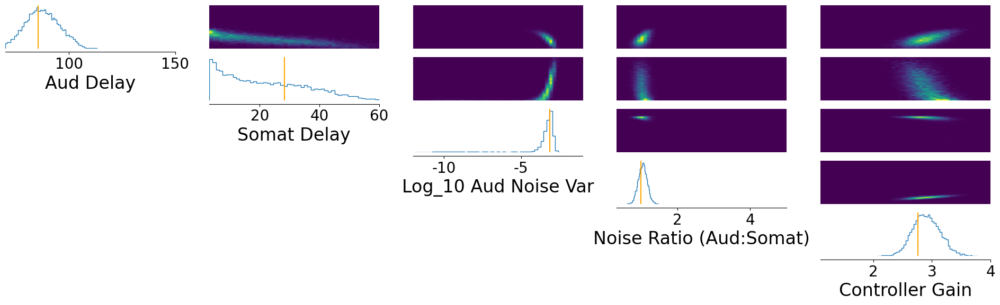

MSE: [0.58997073 2.77378232]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([109.2733,  15.6813, -10.0548,   2.1155,   2.2209])


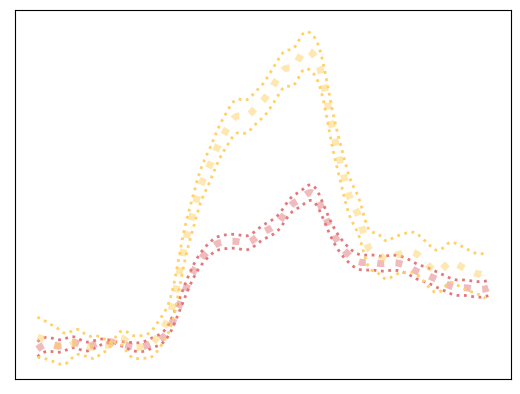

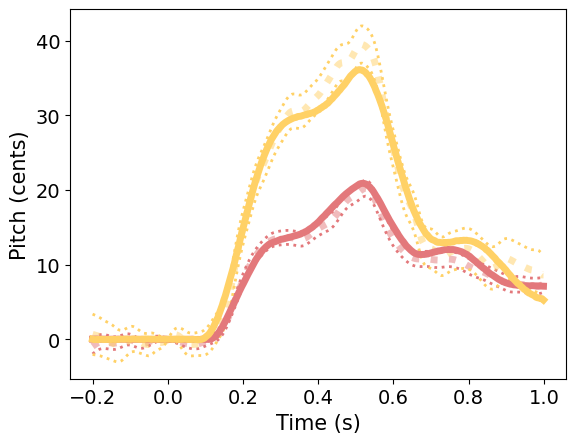

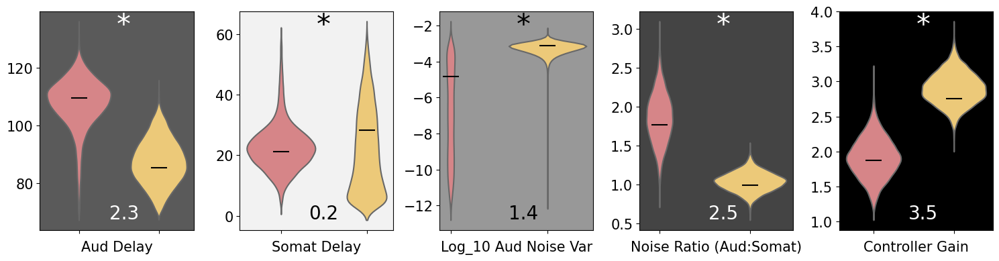

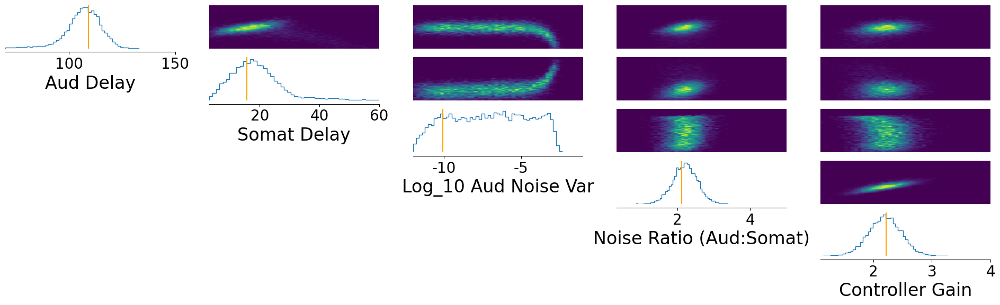

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.2218, 12.6832, -3.2132,  1.0397,  3.1038])


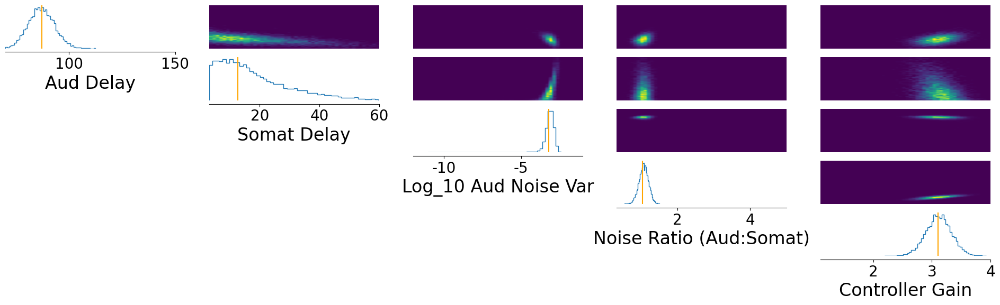

MSE: [0.5226098  2.24556249]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.8294,  26.2221,  -4.0518,   1.9899,   2.0698])


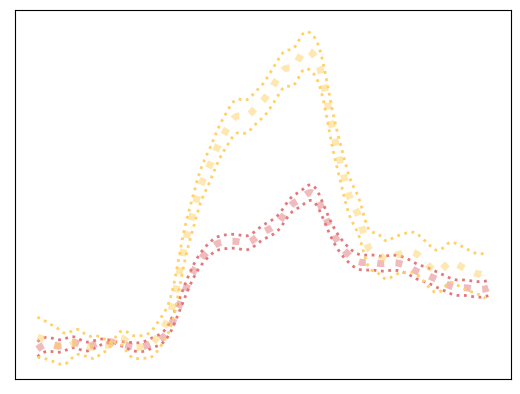

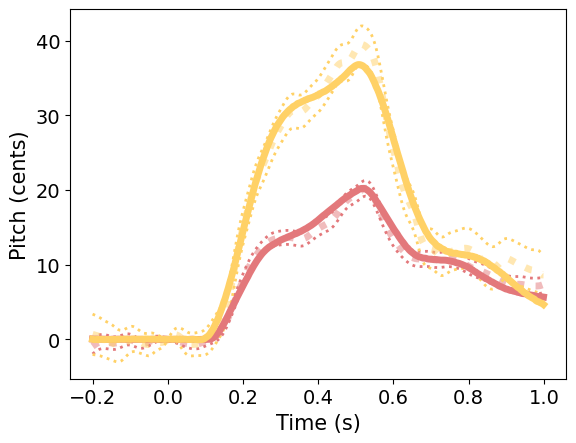

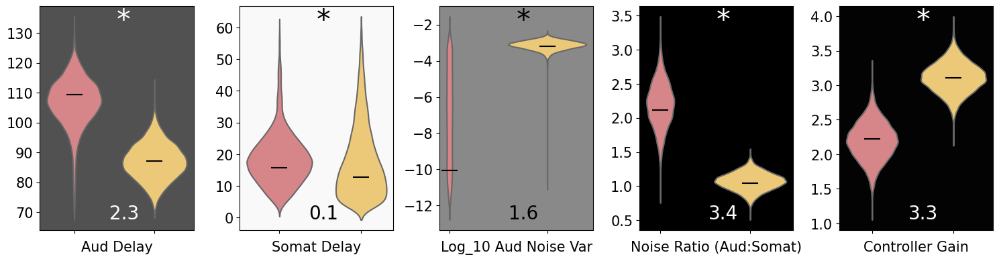

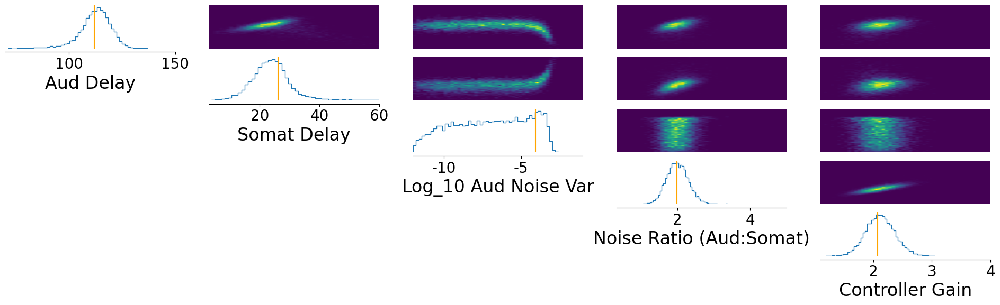

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([92.6233,  9.2083, -3.5542,  1.0333,  3.0059])


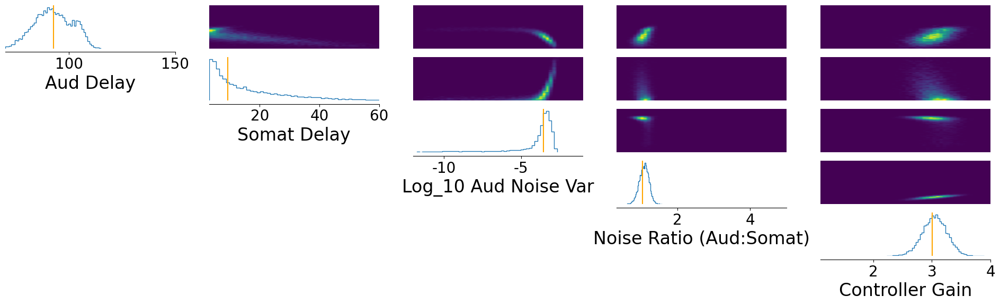

MSE: [0.55324698 2.78031101]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([100.7461,  13.5515,  -7.8817,   1.5780,   1.7398])


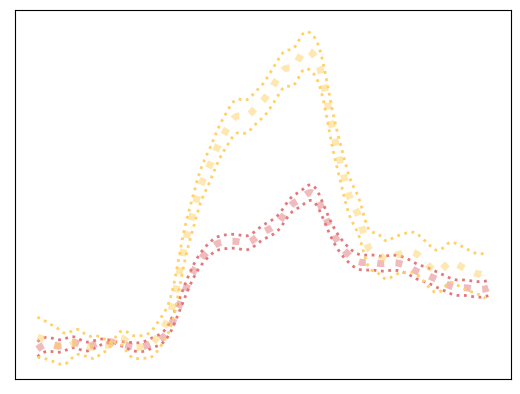

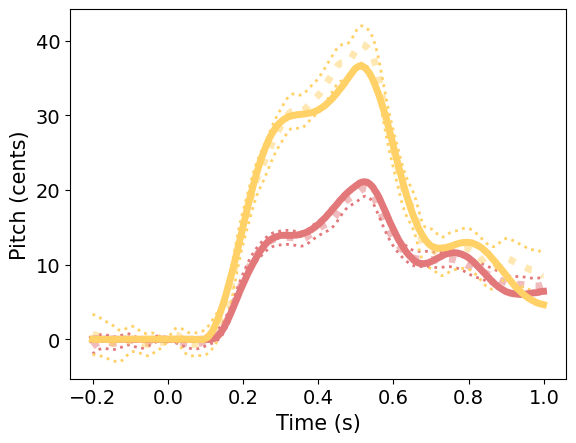

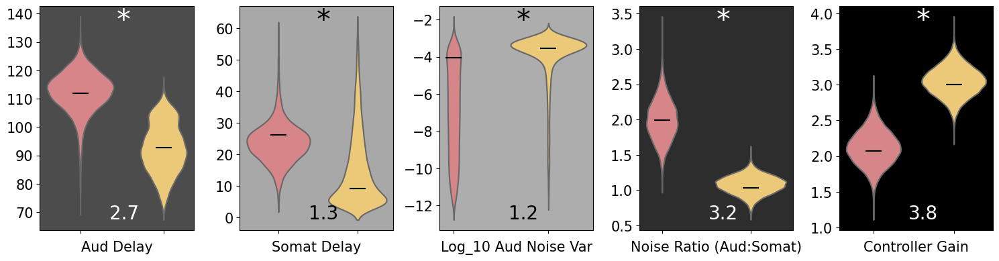

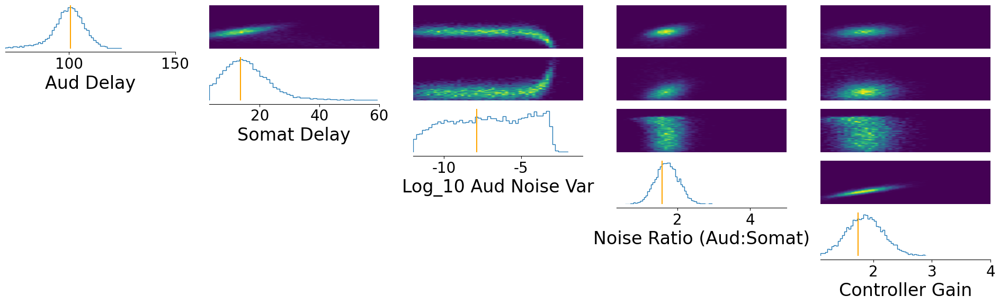

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([88.1811, 14.0981, -3.4033,  0.9542,  2.9775])


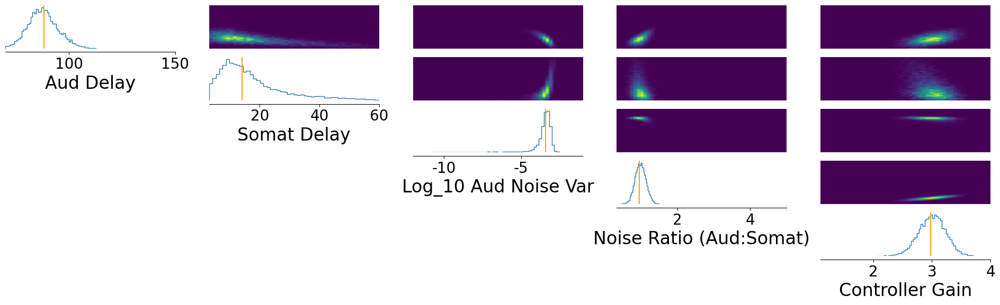

MSE: [1.23102717 2.98113516]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.3885,  17.9489, -10.0345,   1.7725,   1.8147])


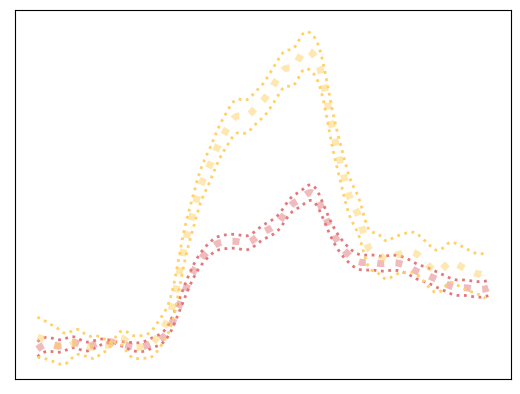

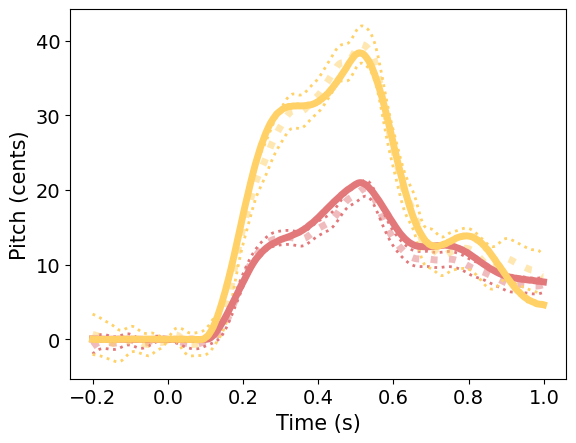

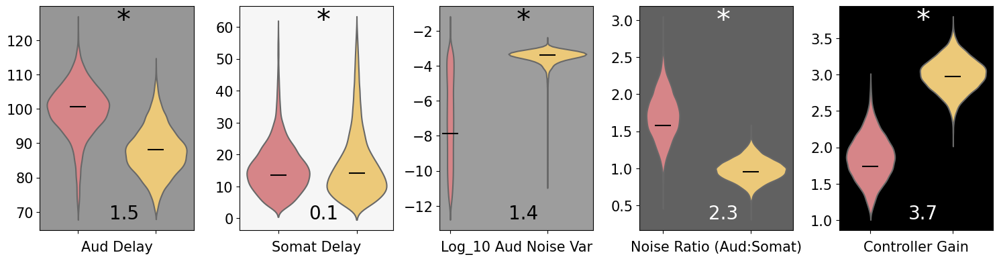

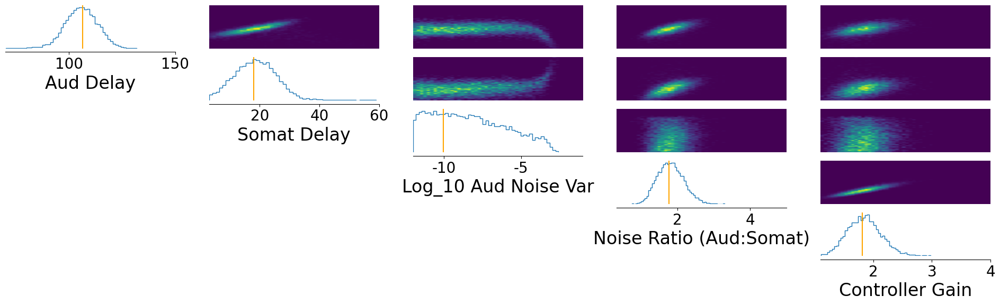

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.9992, 11.2979, -3.2291,  0.9388,  2.9760])


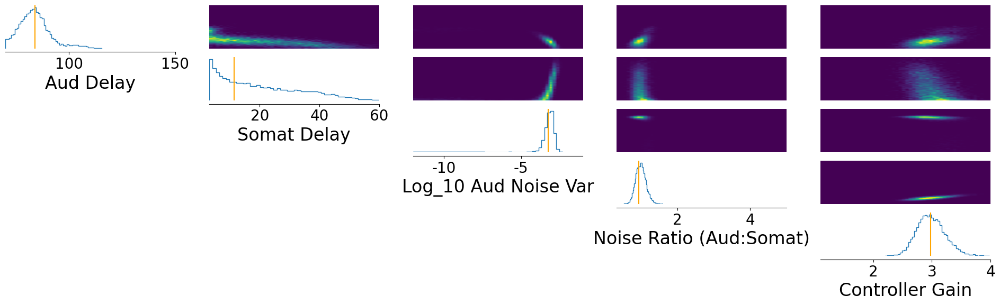

MSE: [0.52363225 2.25793197]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.4266,  21.2758,  -9.7365,   2.0371,   2.0402])


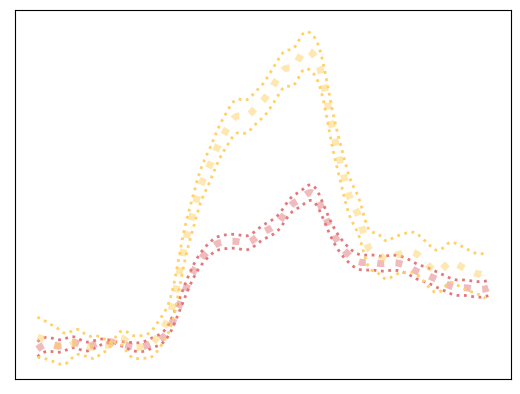

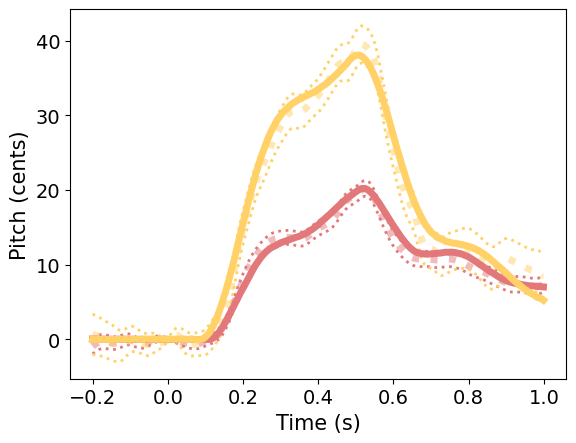

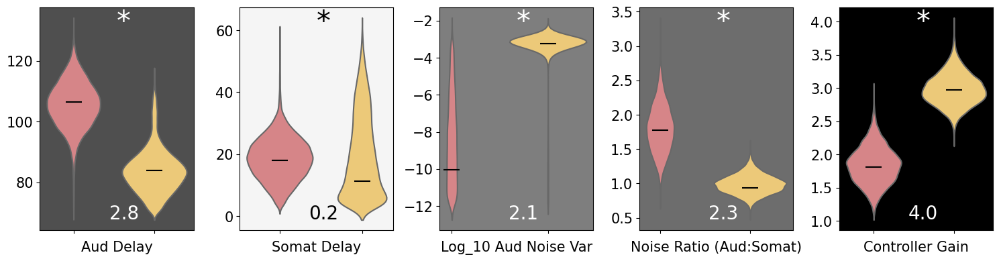

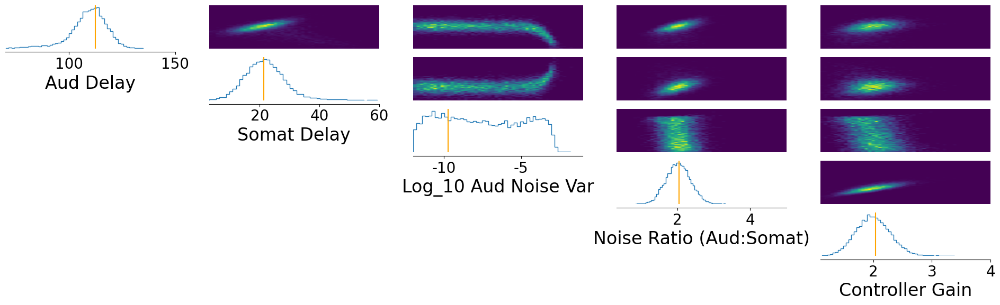

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.5516,  7.0538, -3.4821,  1.0055,  3.0130])


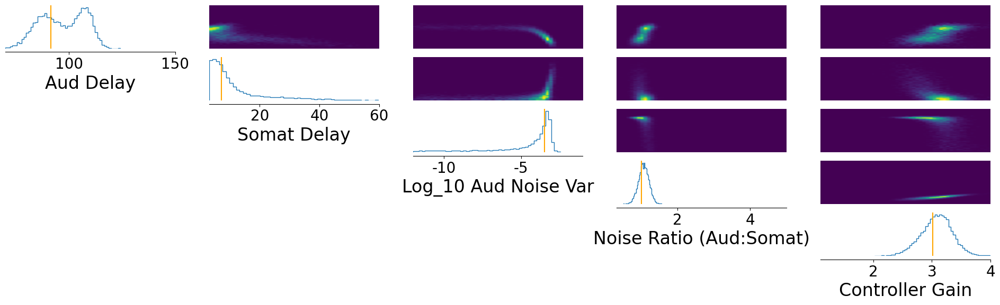

MSE: [0.33635637 2.31100372]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.8881,  24.6184,  -7.0854,   1.7887,   1.8441])


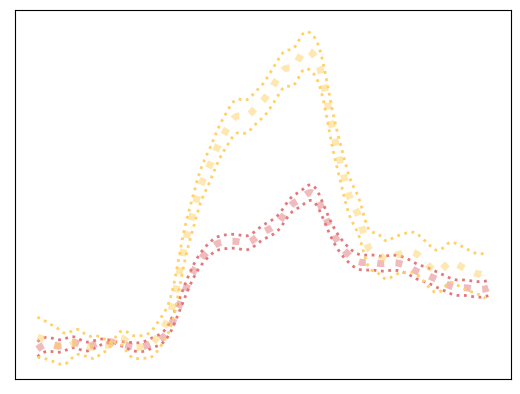

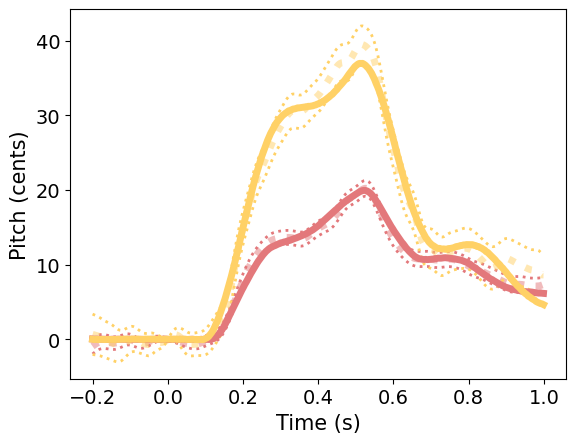

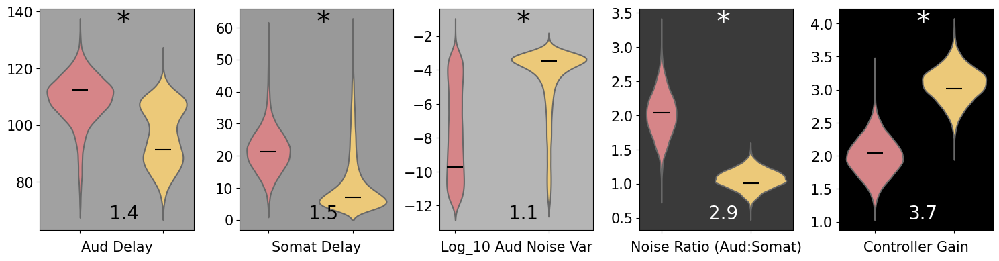

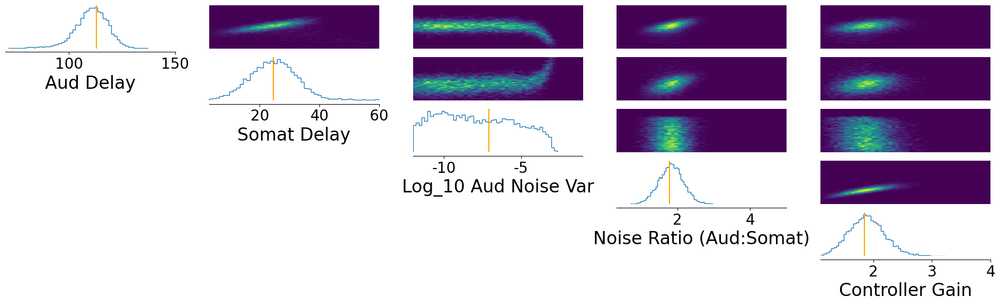

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.9515, 16.5049, -3.2739,  0.8185,  2.8371])


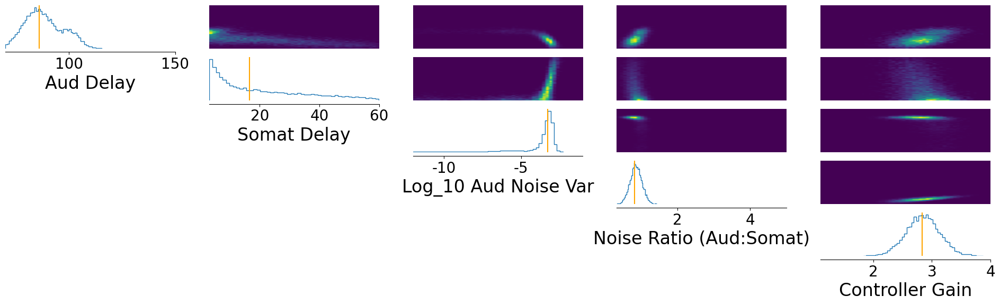

MSE: [0.47505142 4.06269736]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([104.0274,  25.6575,  -4.1309,   1.8388,   1.8462])


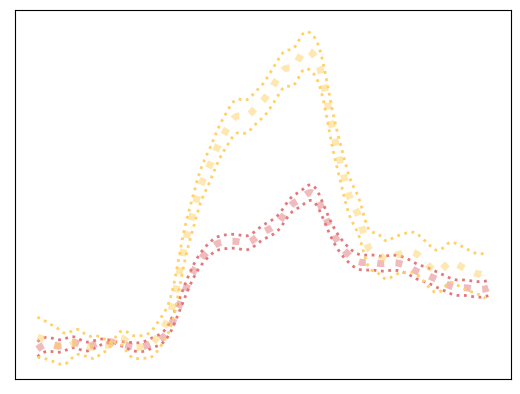

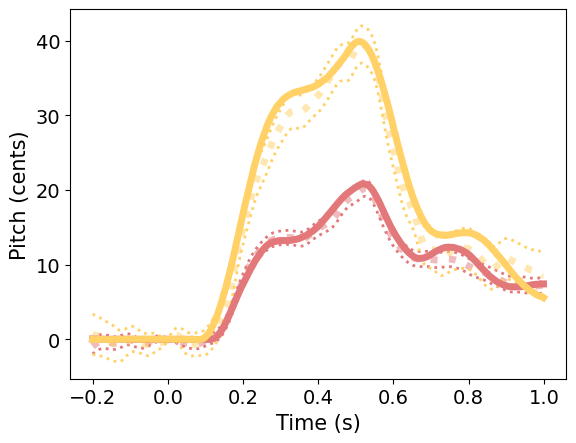

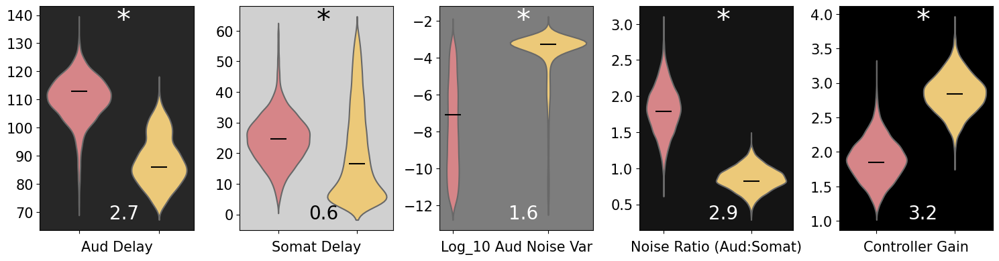

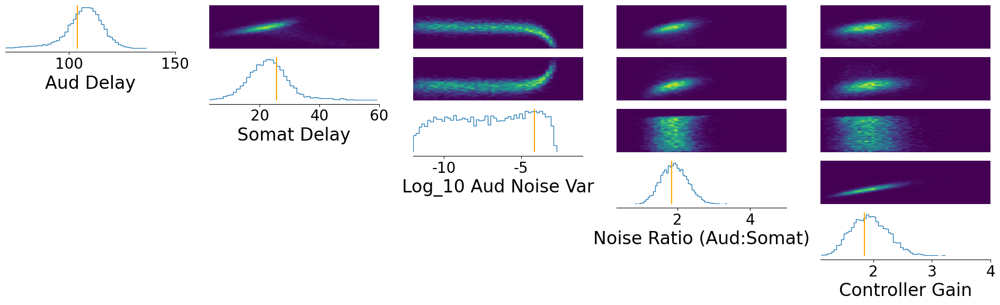

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([81.4022, 26.4740, -3.0659,  0.9335,  2.8683])


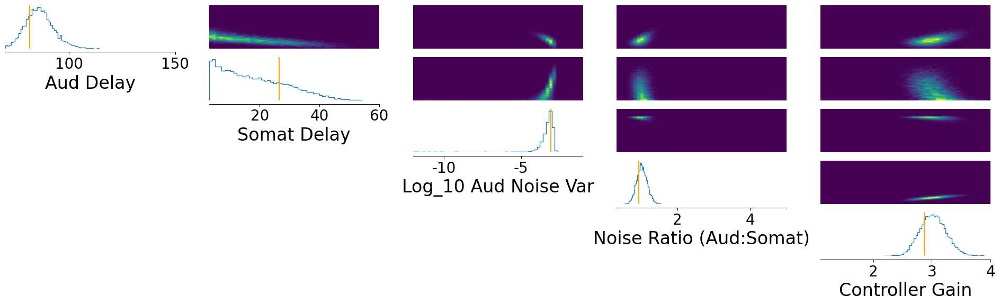

MSE: [0.34793563 2.29722563]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([107.8379,  18.9751,  -9.8408,   1.9331,   2.0722])


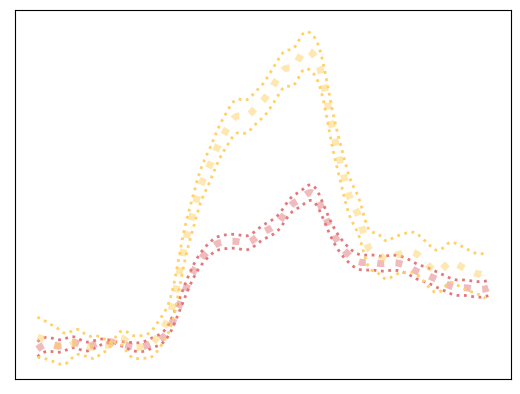

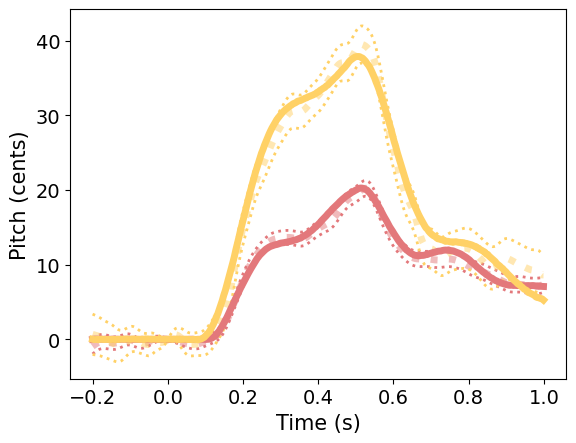

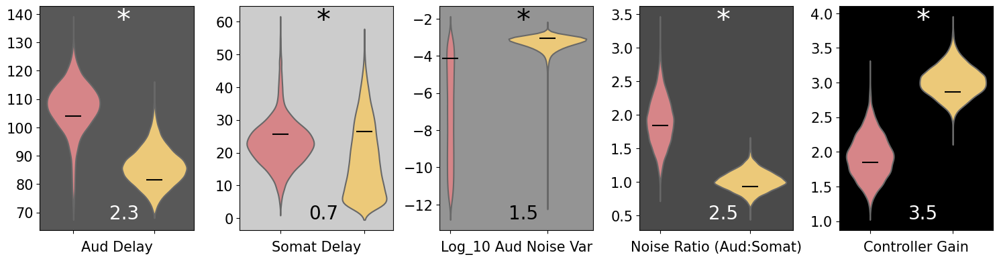

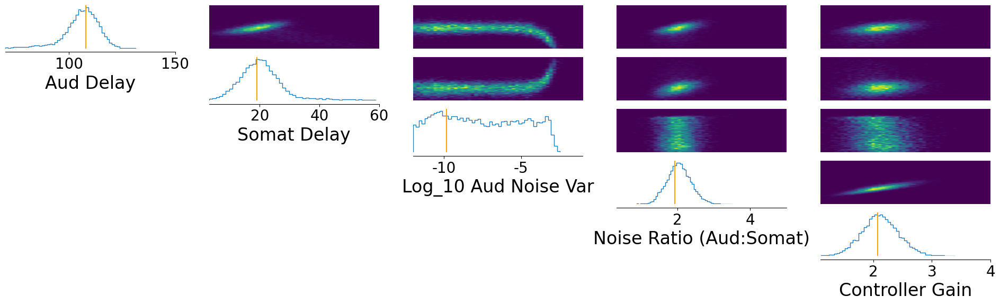

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([86.9397, 17.7878, -3.2899,  0.9392,  3.0035])


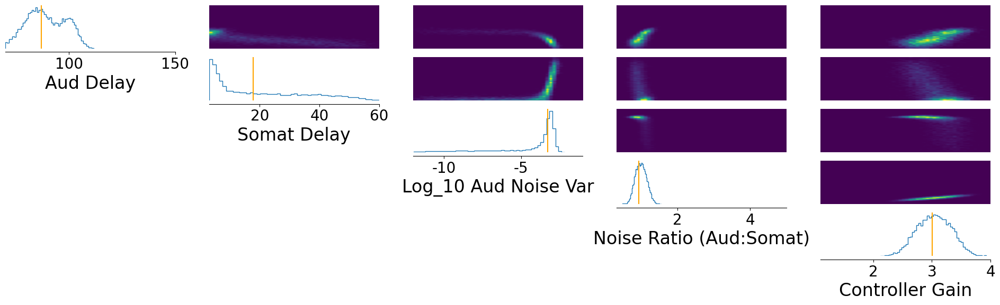

MSE: [0.52516239 2.54868736]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([115.2188,  22.0113,  -8.3048,   1.8828,   1.9281])


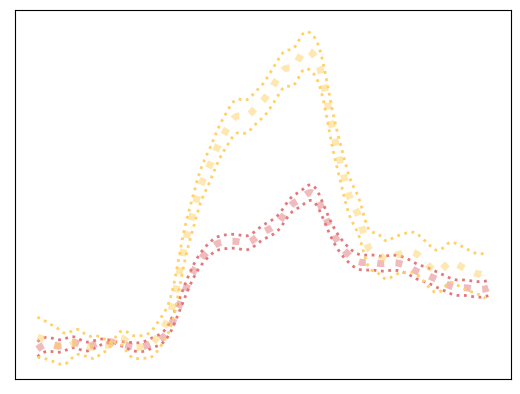

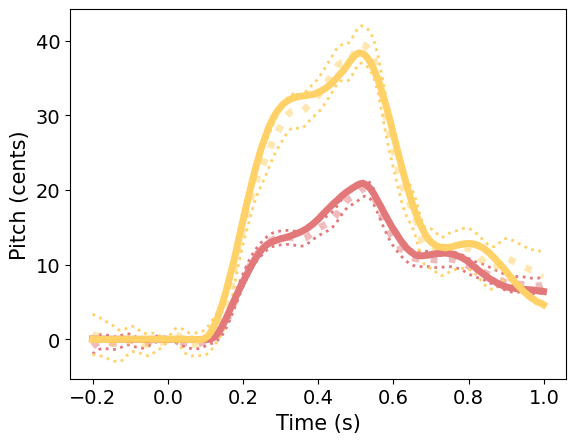

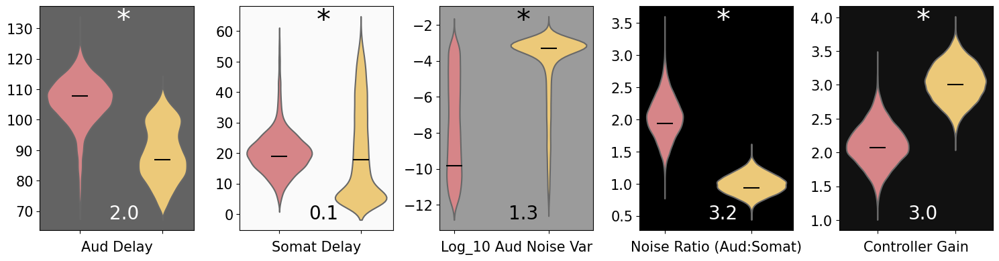

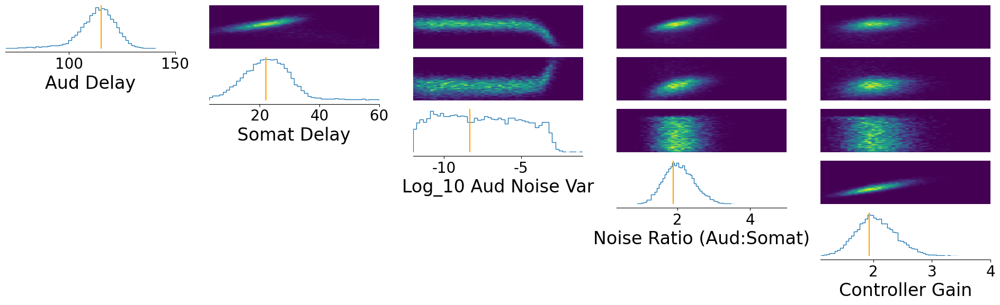

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.3803, 12.5393, -3.4156,  1.0323,  3.0282])


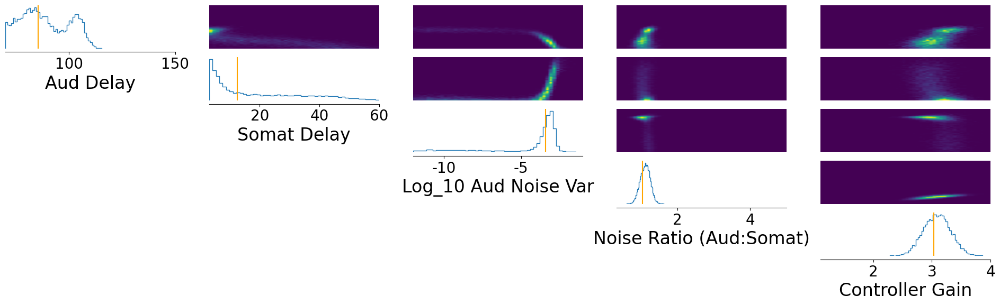

MSE: [0.44024509 3.18889948]


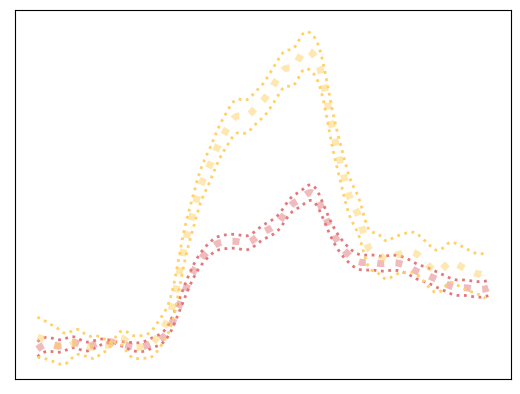

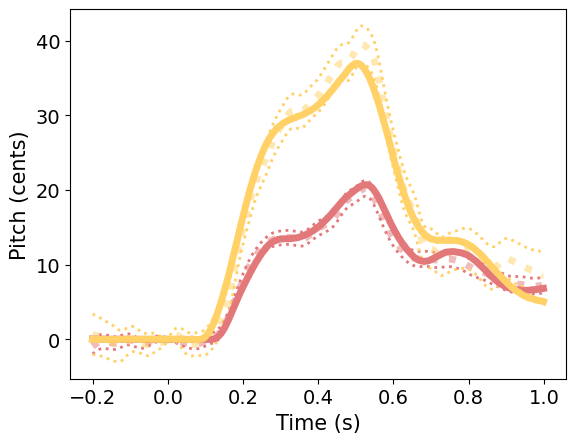

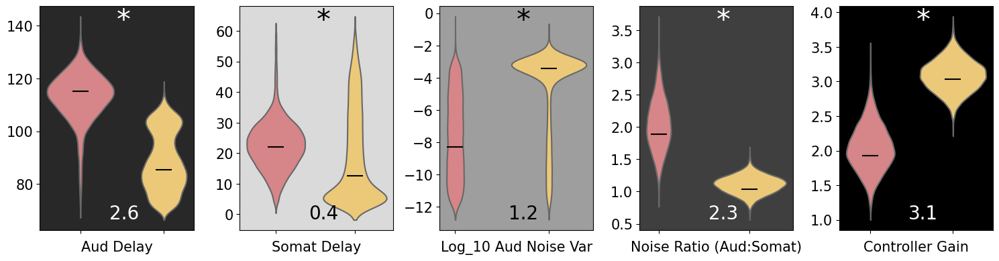

In [18]:
def simulator(parameter_set):
    training_noise_scale = 5
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

data_list,inferred_control_values_all, mse_vals[1,:,:] = run_sbi('training_noise_5',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.5539,  20.4215,  -5.2136,   1.8282,   1.8801])


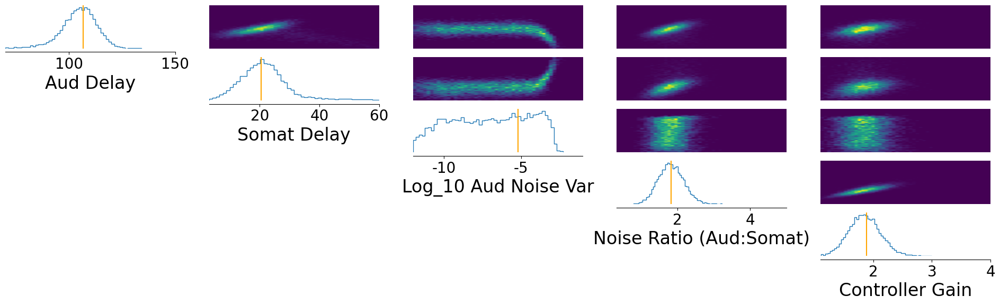

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([96.3375,  3.4429, -3.8421,  1.0734,  3.0340])


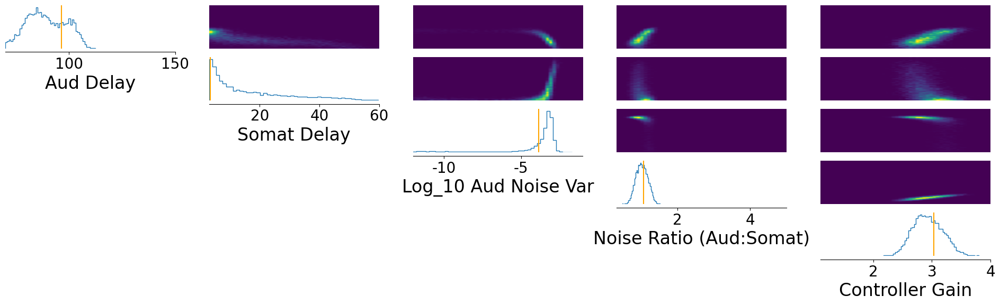

MSE: [0.39612365 3.8623158 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([89.4816, 38.1764, -3.1947,  1.7305,  1.7965])


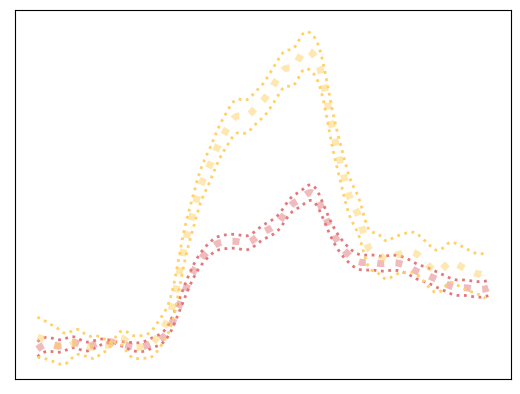

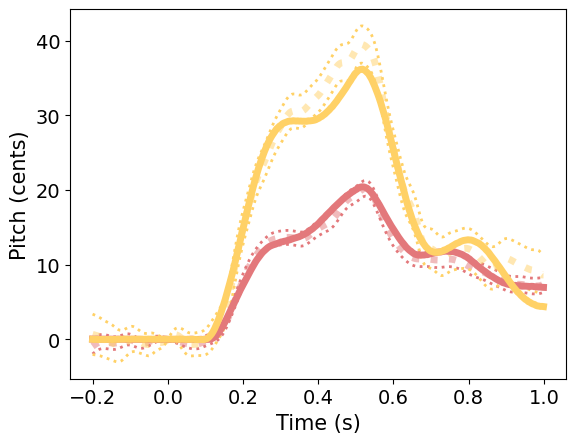

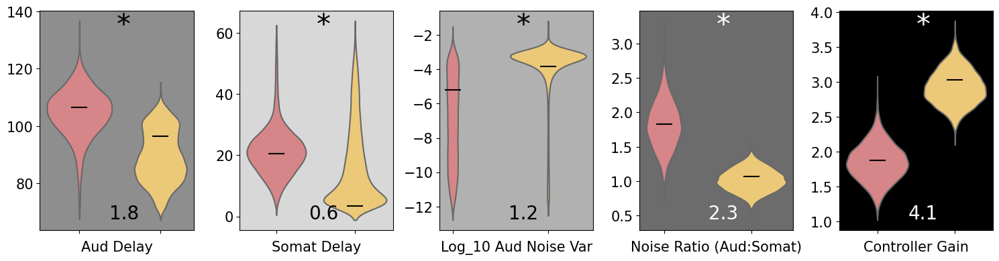

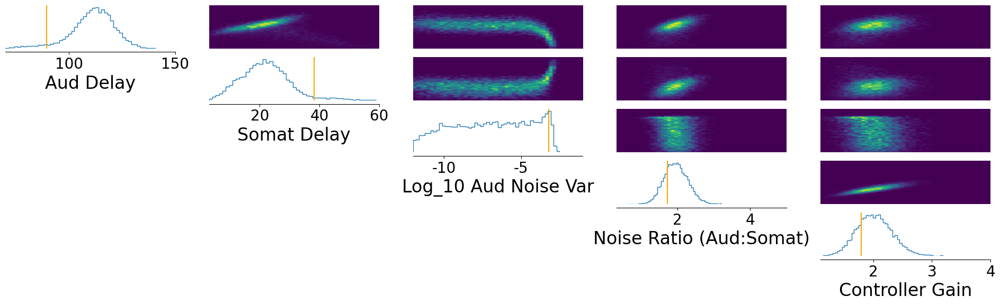

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([86.3574, 16.6106, -3.2457,  0.9794,  2.9627])


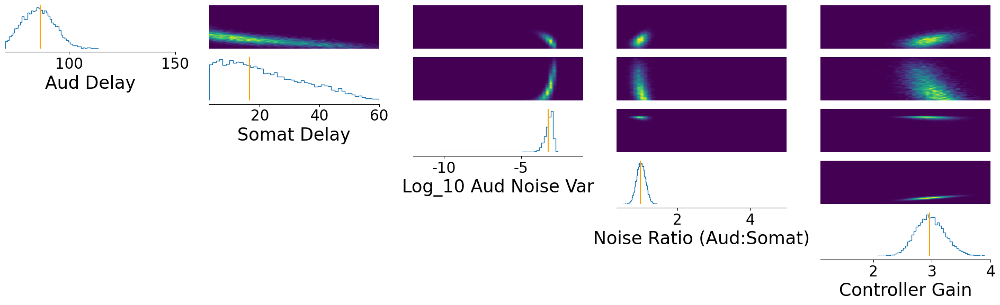

MSE: [0.86771345 2.07103642]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([115.3620,  25.4550,  -8.2445,   1.9771,   1.9961])


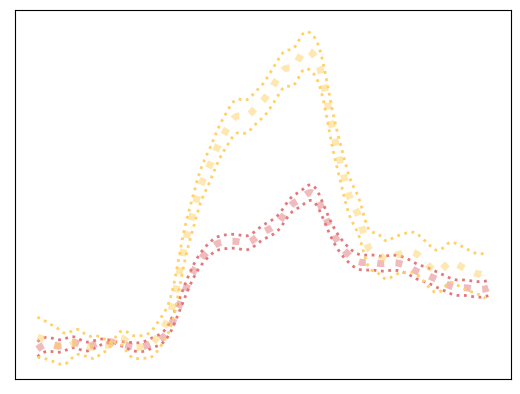

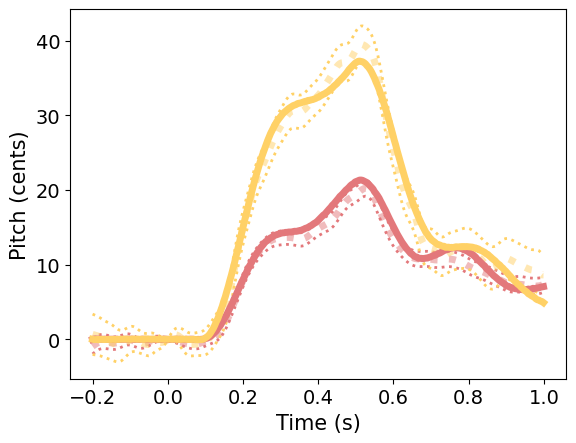

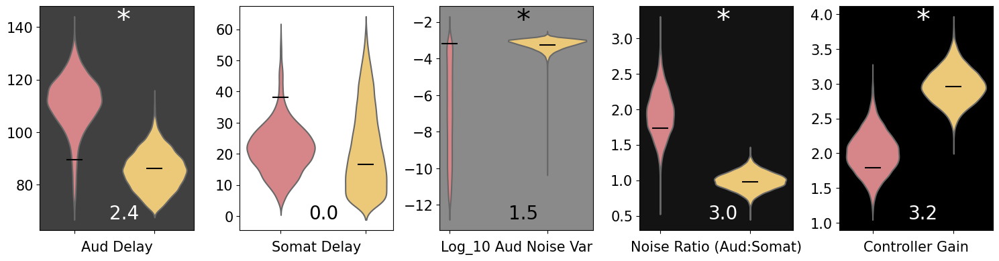

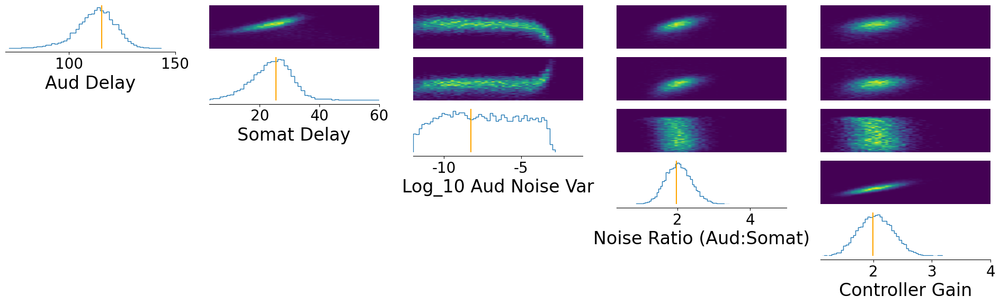

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.4748, 19.1200, -3.3203,  1.0963,  2.9611])


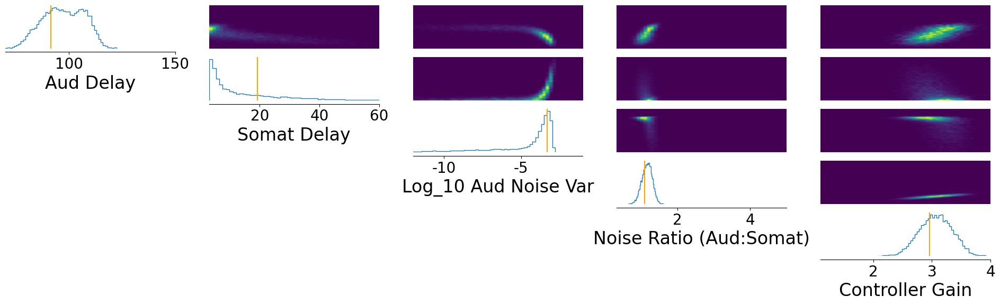

MSE: [0.34694312 3.78894466]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([114.3231,  23.0972,  -9.2967,   2.2118,   2.1859])


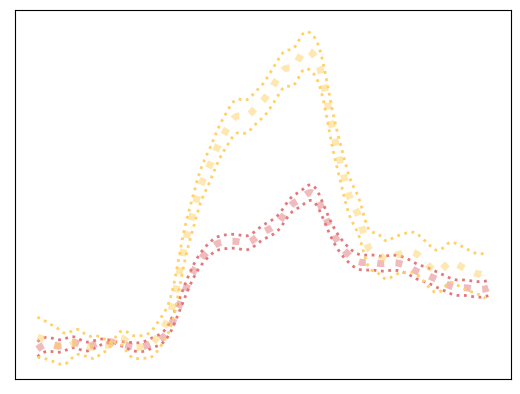

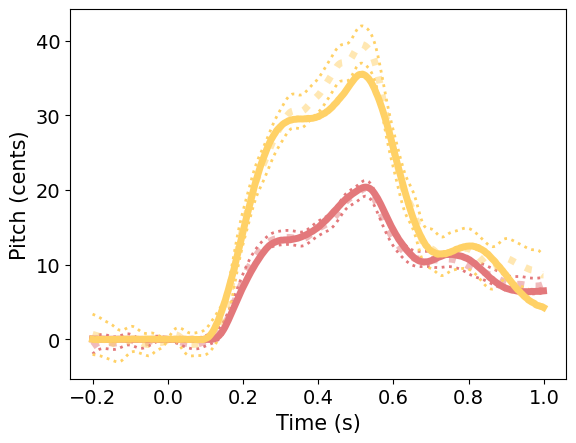

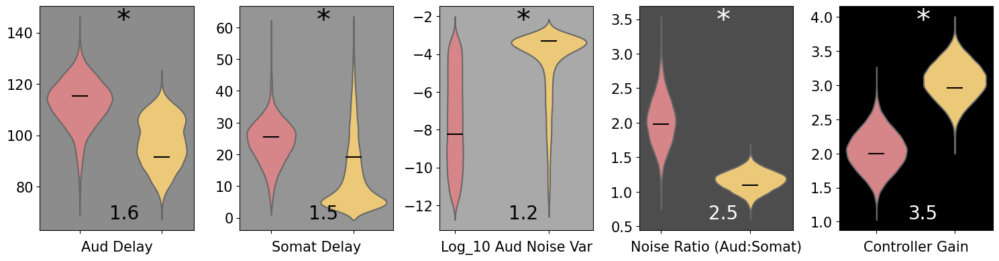

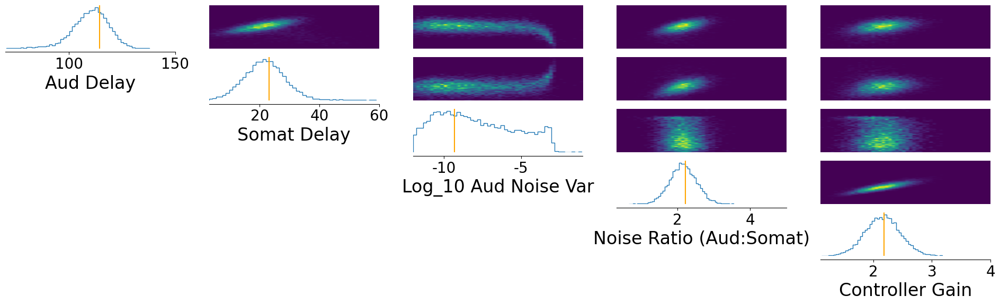

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([90.1755, 11.5972, -3.3180,  1.0448,  3.0043])


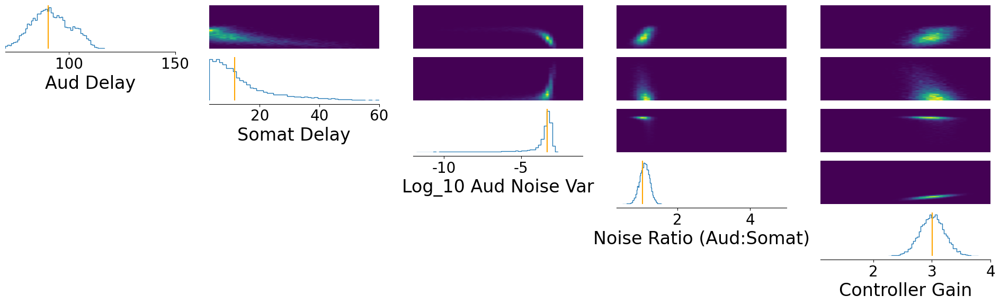

MSE: [0.4434789  2.45380578]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.6275,  19.9896,  -7.0582,   1.9993,   2.0391])


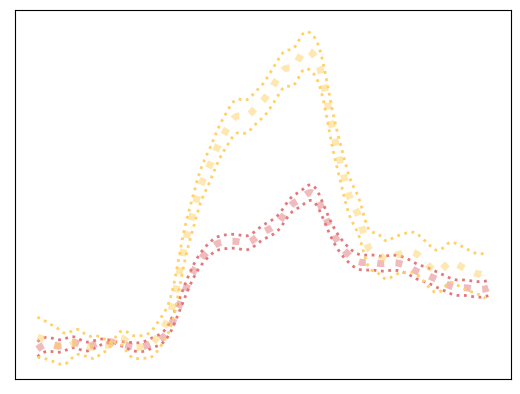

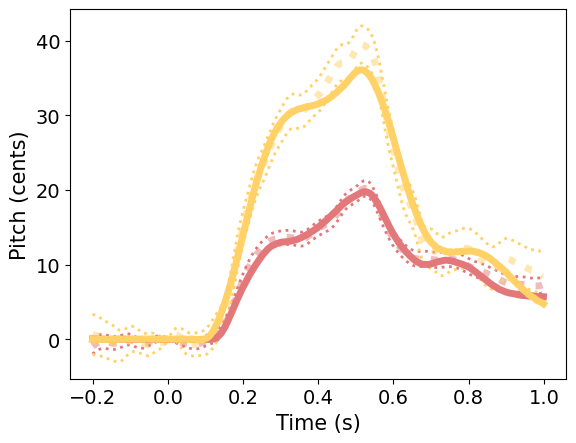

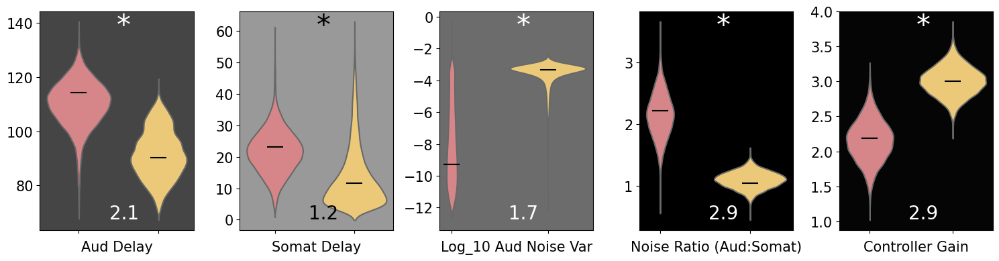

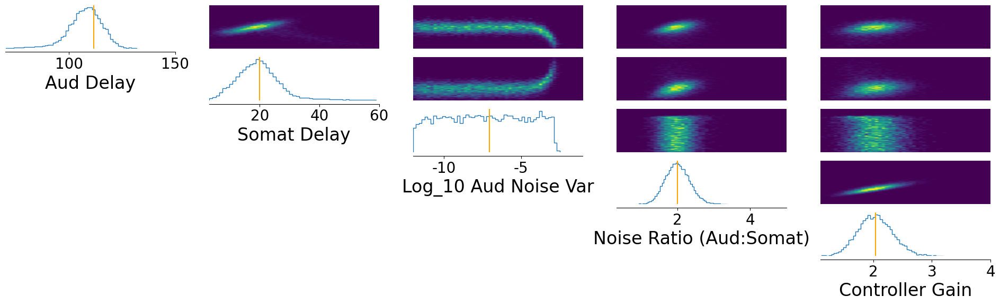

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([82.4735, 29.2697, -3.0507,  0.9505,  2.8755])


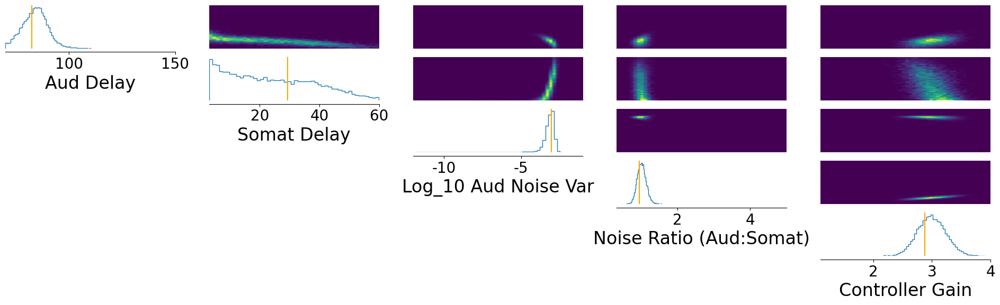

MSE: [0.34959731 2.1383638 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([110.4902,  19.7547,  -9.4537,   1.8979,   1.9618])


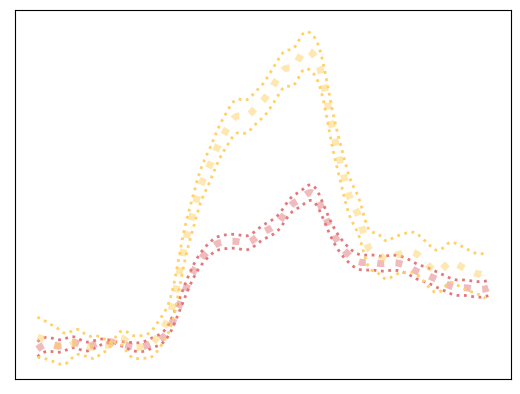

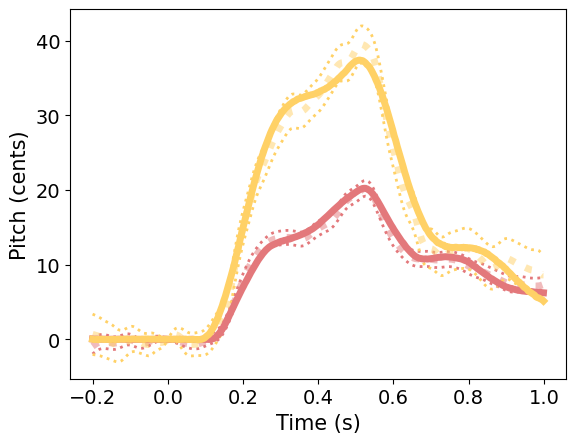

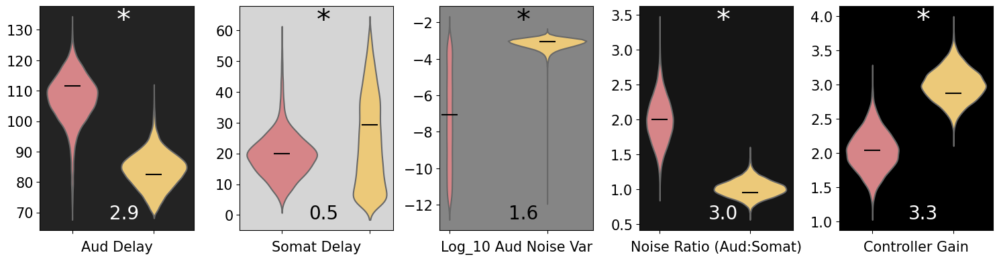

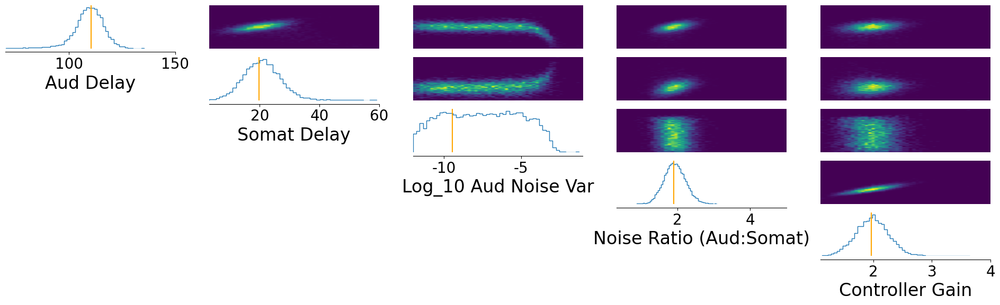

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.2486, 12.1356, -3.2218,  0.9697,  2.9845])


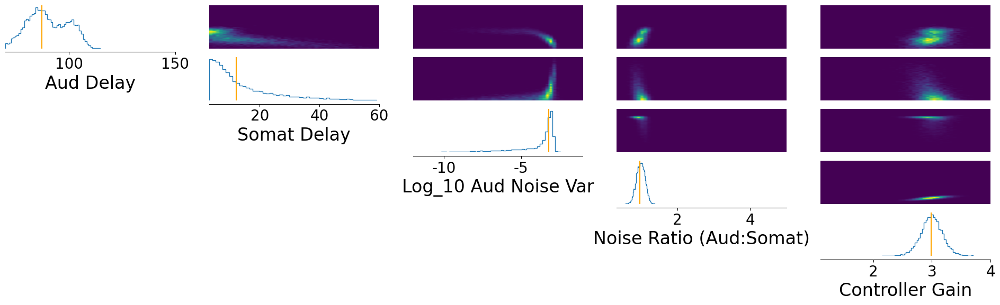

MSE: [0.40916442 2.09650257]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.1525,  23.8577, -10.3454,   1.9613,   1.9923])


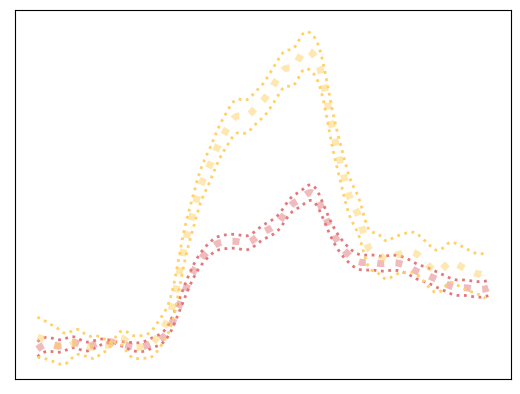

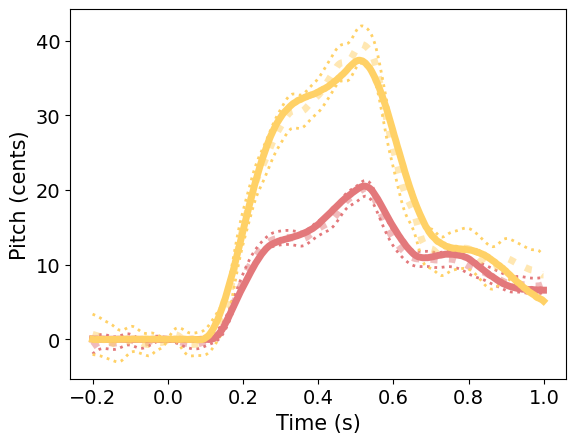

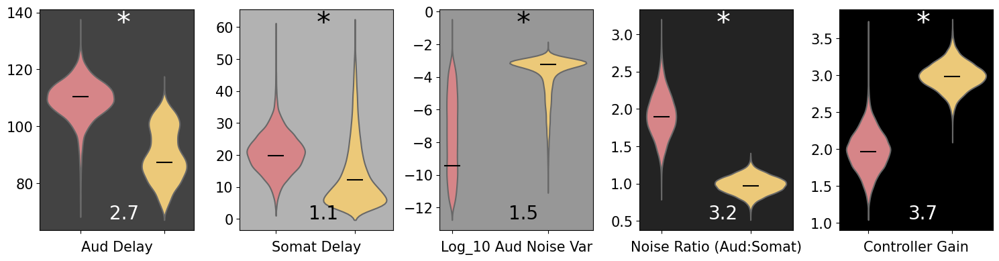

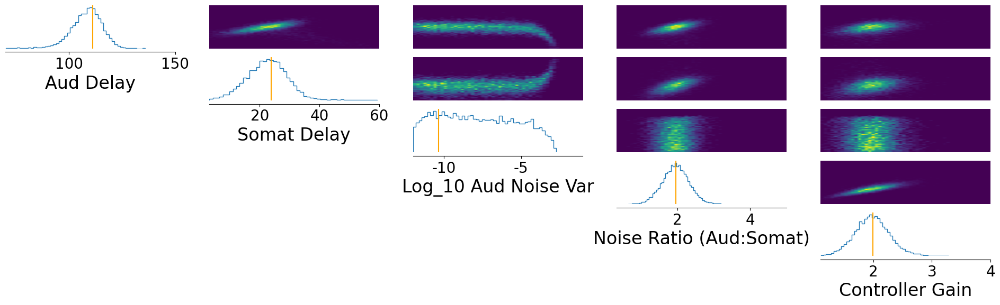

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.1705,  3.4500, -3.5826,  1.0428,  3.0676])


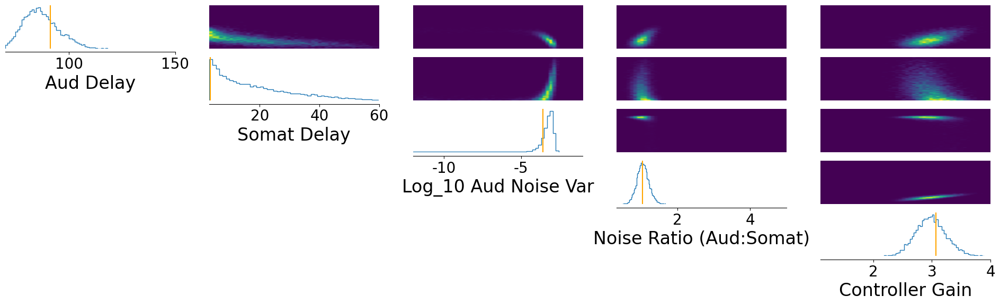

MSE: [0.29623687 2.55503239]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.3547,  22.6258,  -8.1979,   2.0528,   2.1299])


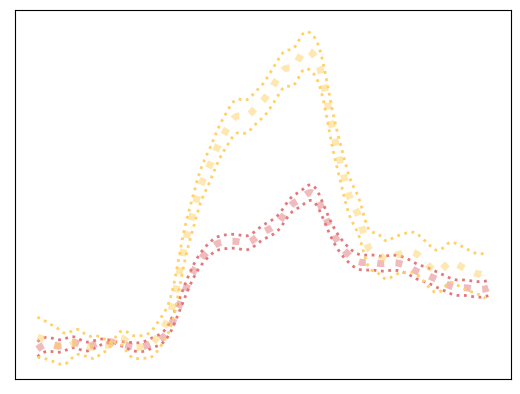

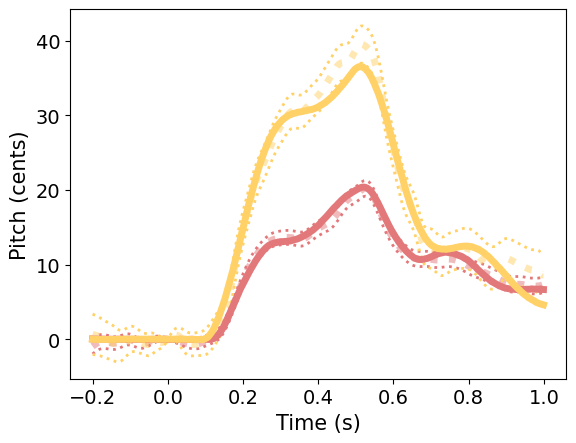

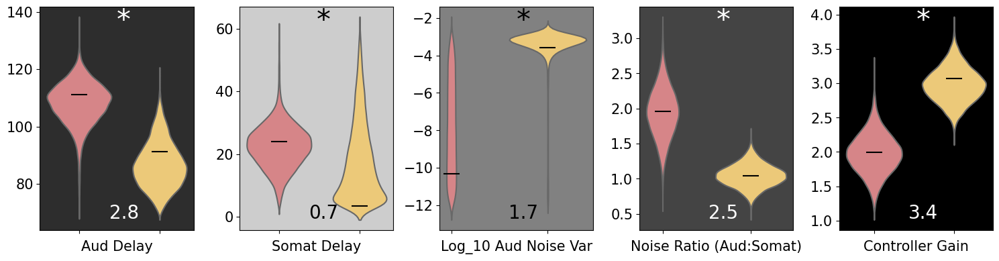

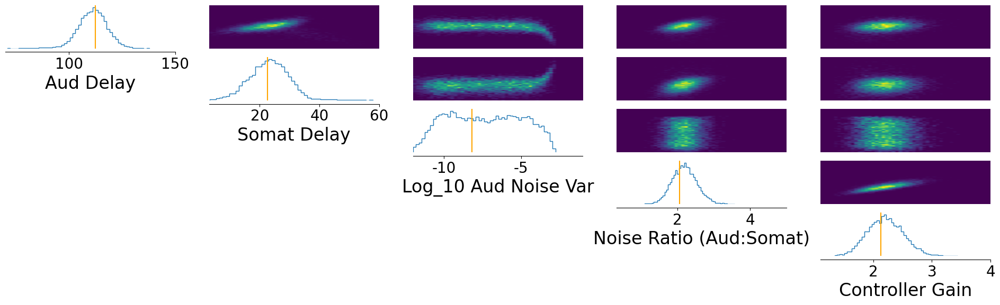

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([88.4058, 15.4886, -3.3055,  1.0397,  3.0458])


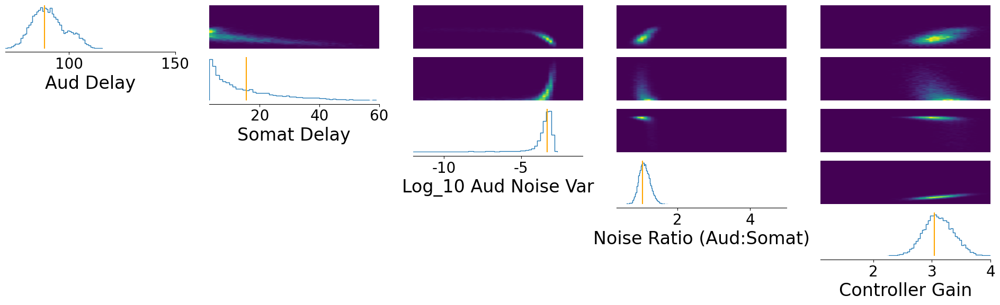

MSE: [0.37485492 2.52768053]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([112.4289,  20.1030,  -9.7253,   2.1231,   2.1811])


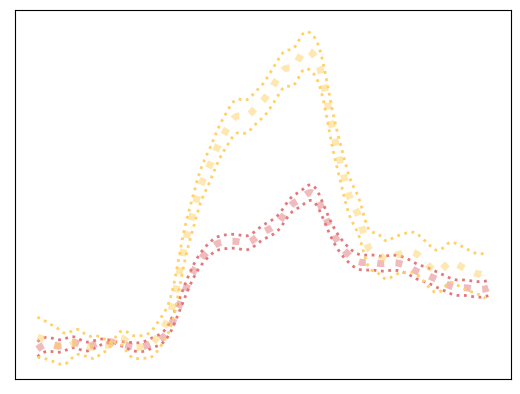

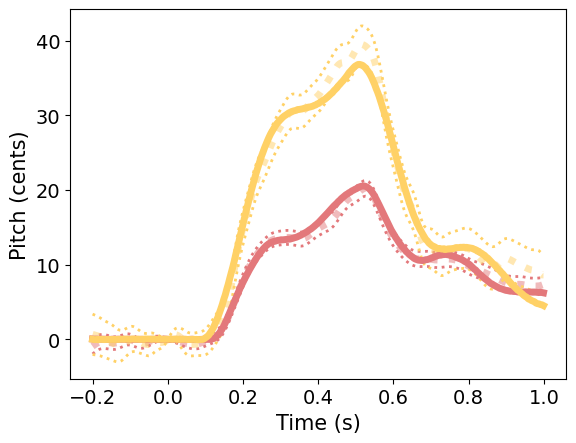

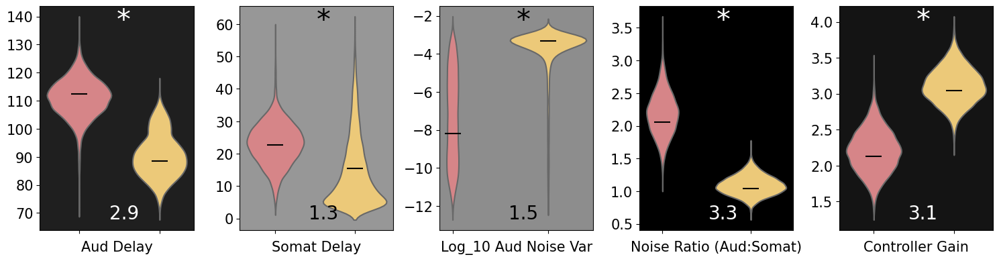

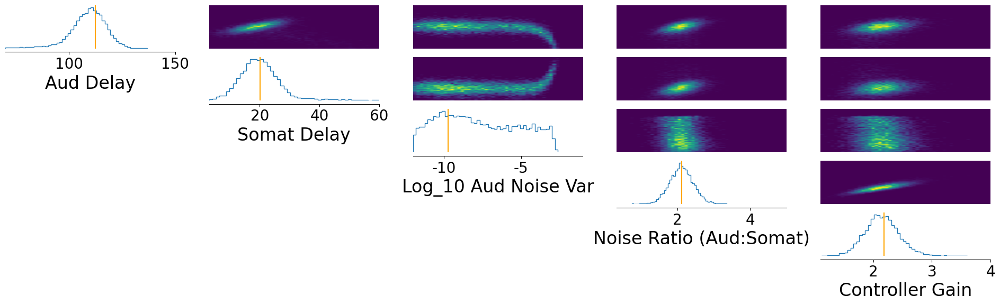

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.9658, 12.2006, -3.1804,  0.8794,  2.8087])


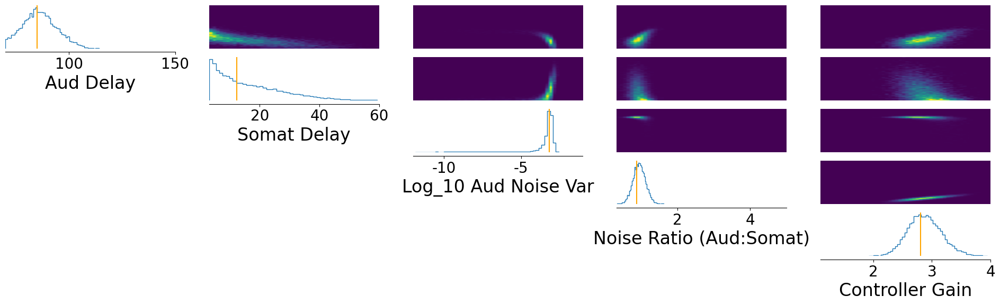

MSE: [0.41664277 2.68205975]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([100.0755,  17.6028,  -4.0256,   1.7172,   1.7491])


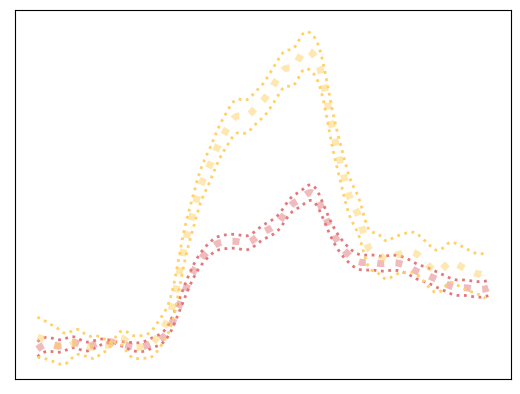

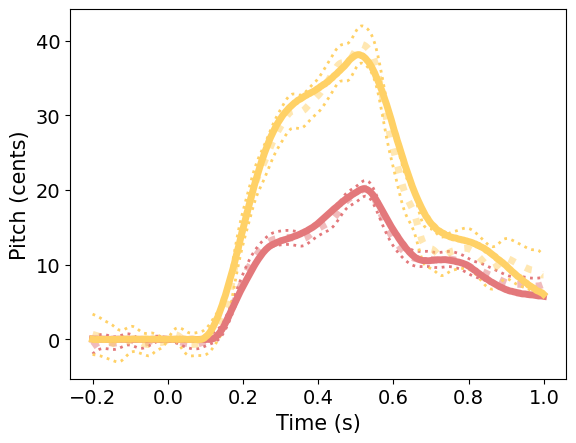

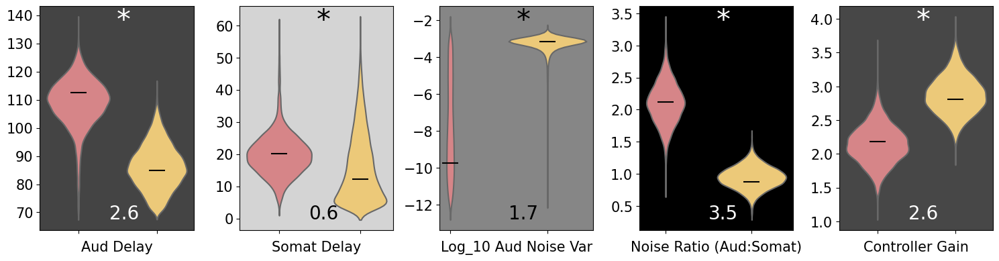

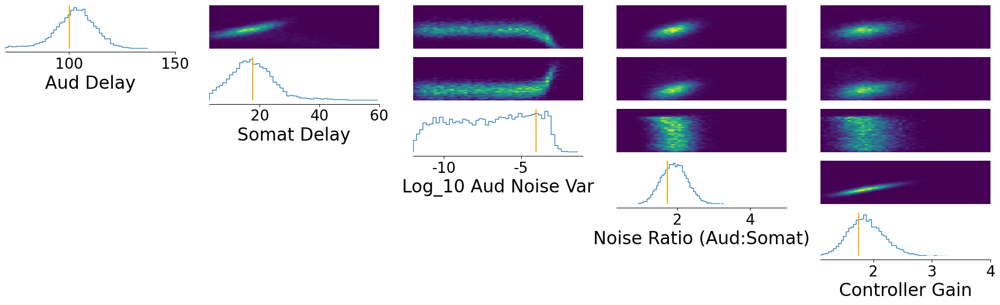

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.7734, 18.7497, -3.0782,  0.9816,  2.9712])


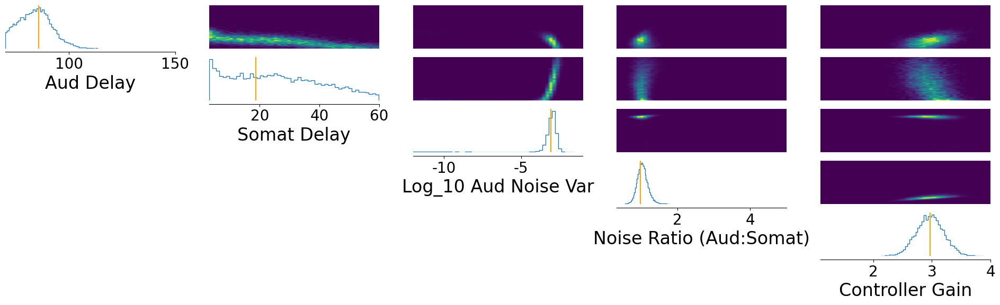

MSE: [0.6690818  2.15155723]


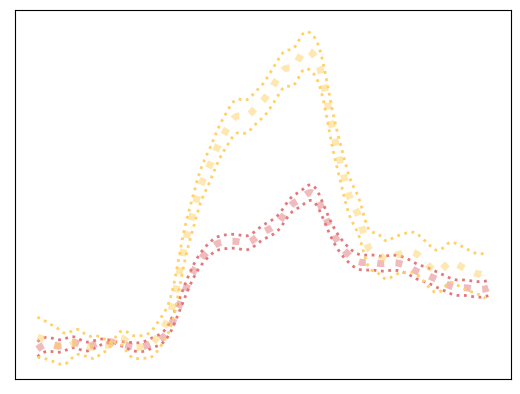

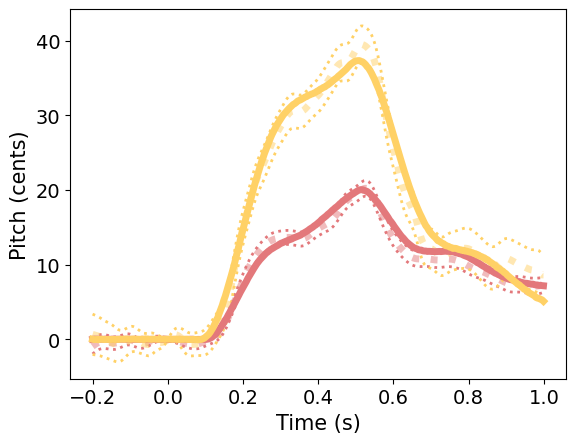

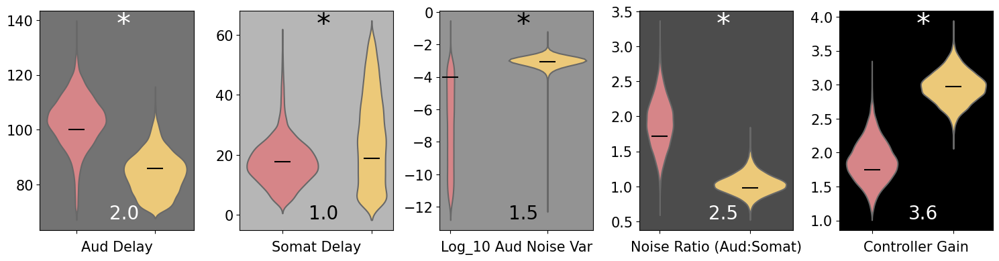

In [19]:
def simulator(parameter_set):
    training_noise_scale = 7
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

data_list,inferred_control_values_all, mse_vals[2,:,:] = run_sbi('training_noise_7',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([94.5340, 31.3067, -3.4676,  1.6153,  1.7469])


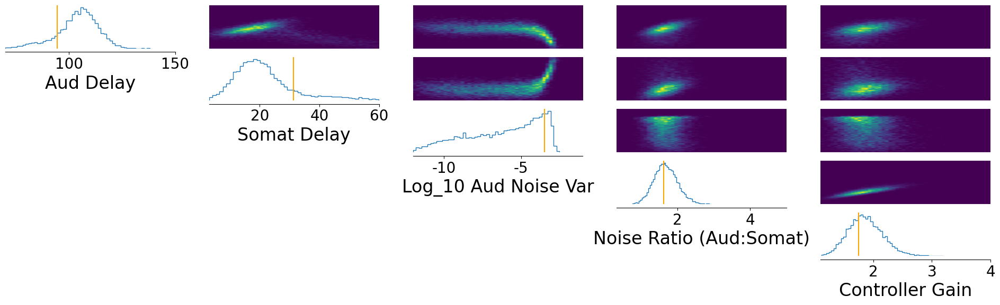

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([85.2409, 20.5745, -3.2405,  0.8750,  2.8401])


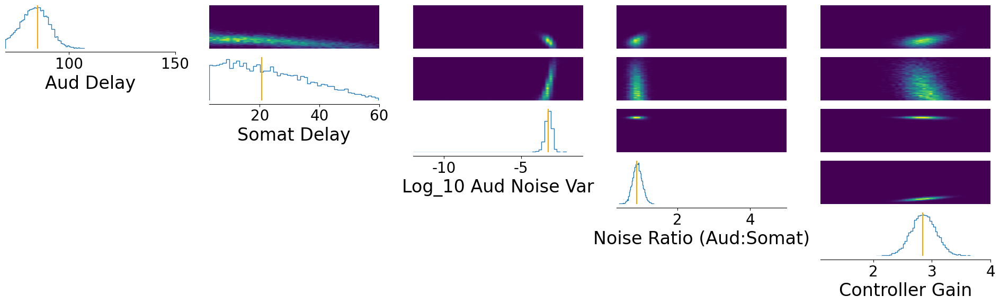

MSE: [1.28978534 2.86477127]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.5178,  17.9401,  -7.6338,   1.6523,   1.7409])


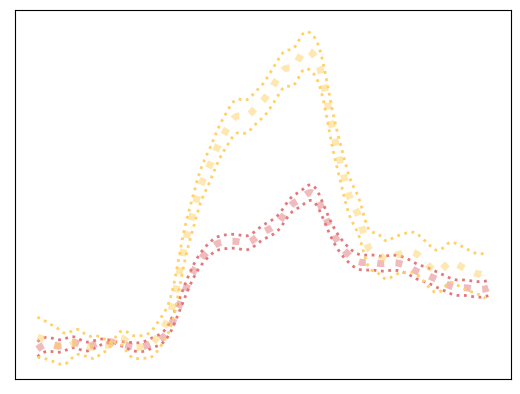

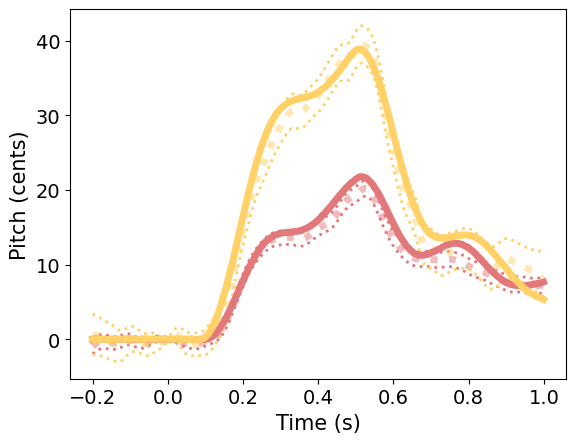

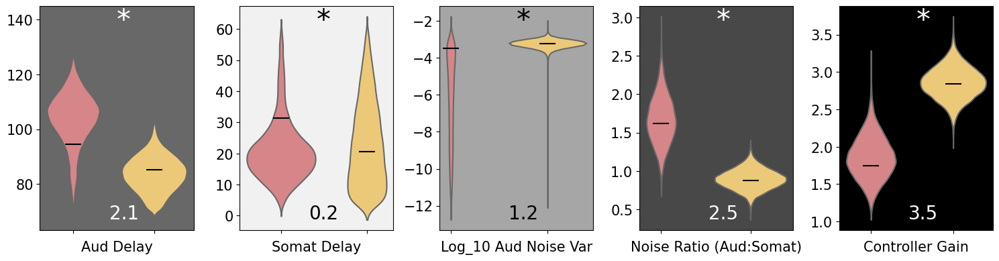

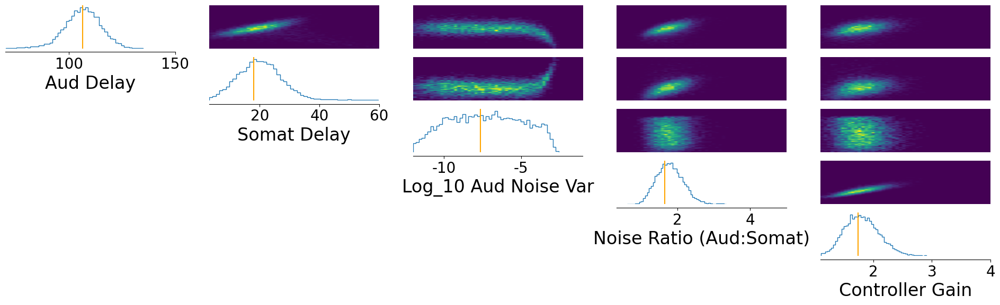

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([87.5111, 11.5367, -3.3526,  0.9158,  2.9202])


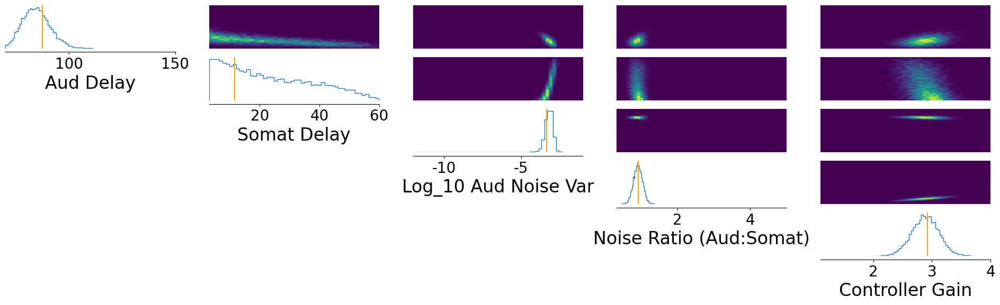

MSE: [0.79465881 2.36751768]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([103.6391,  25.5750,  -4.1015,   1.9208,   1.9753])


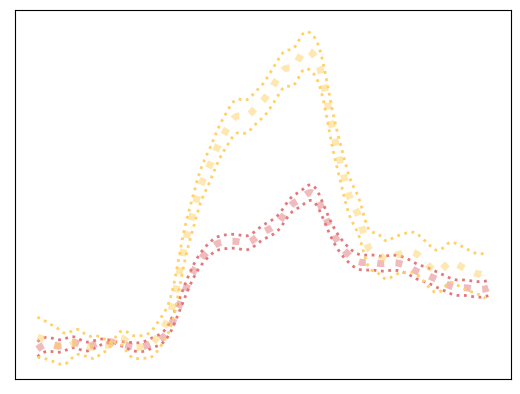

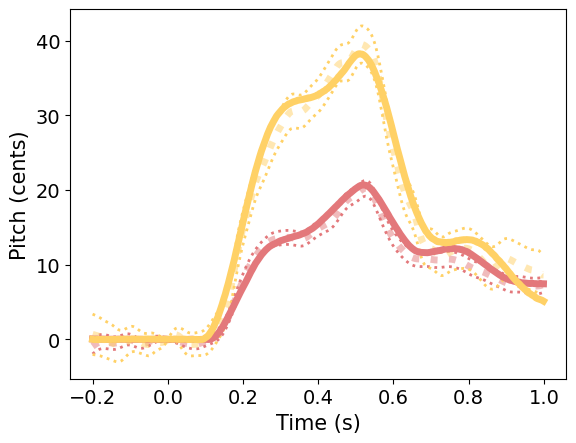

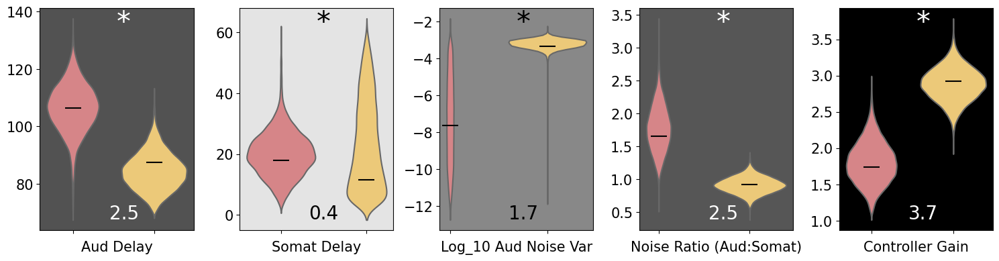

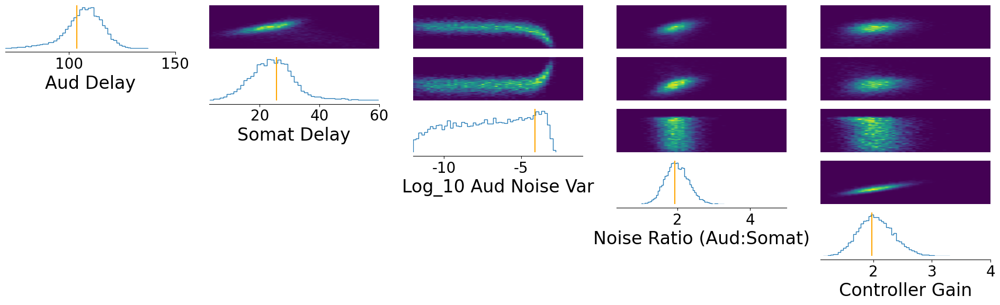

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.6396, 25.7331, -3.2413,  0.9331,  2.9375])


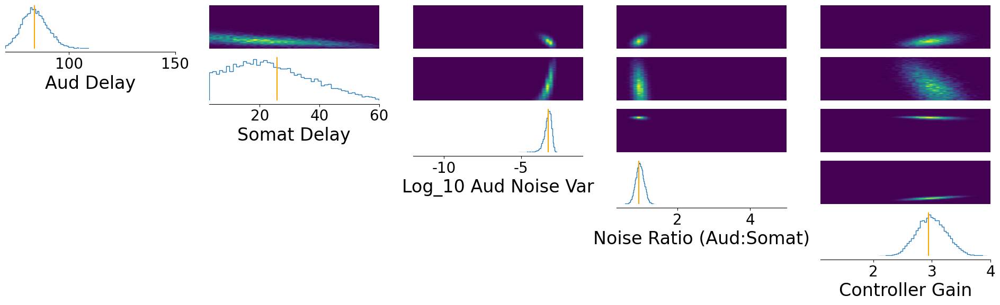

MSE: [0.38050409 3.09420958]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([91.5258, 22.3187, -3.6472,  1.6683,  1.7943])


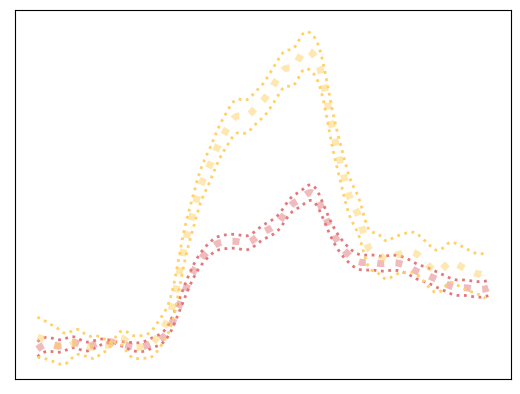

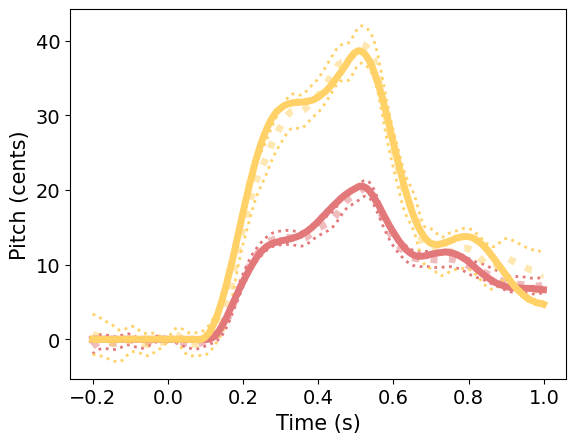

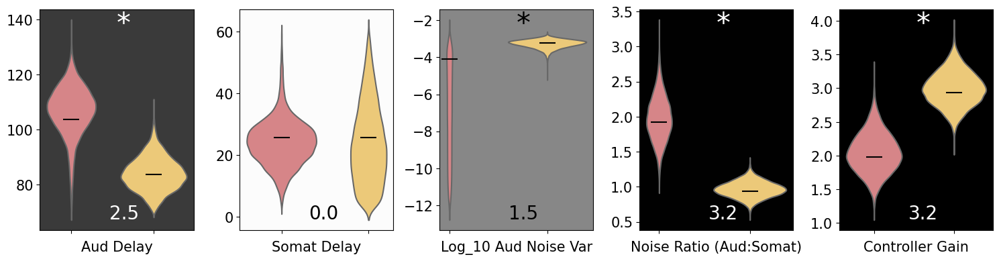

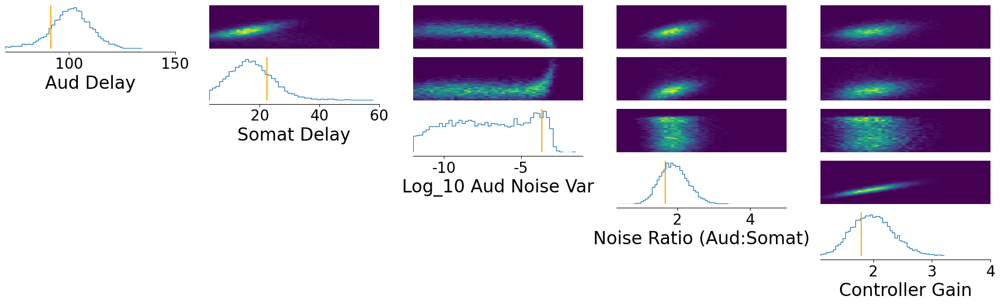

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.1986,  6.5315, -3.2355,  0.9106,  2.9617])


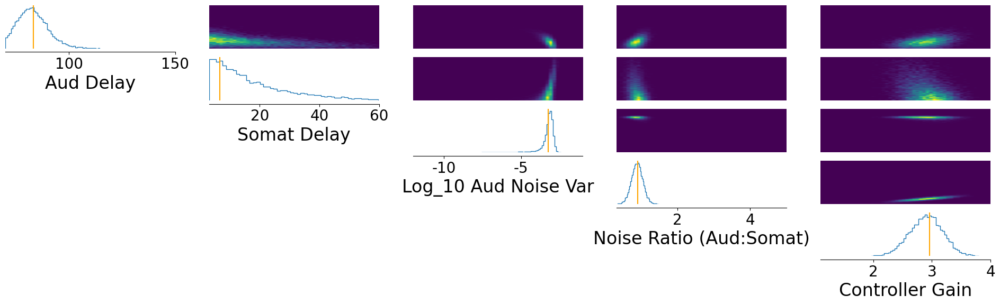

MSE: [1.06838495 2.53575707]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([111.1084,  25.1792, -10.3476,   2.0998,   2.0003])


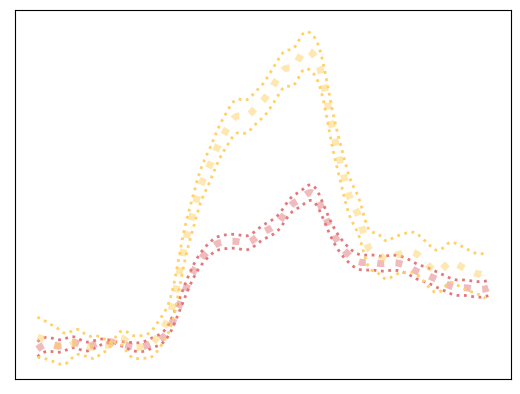

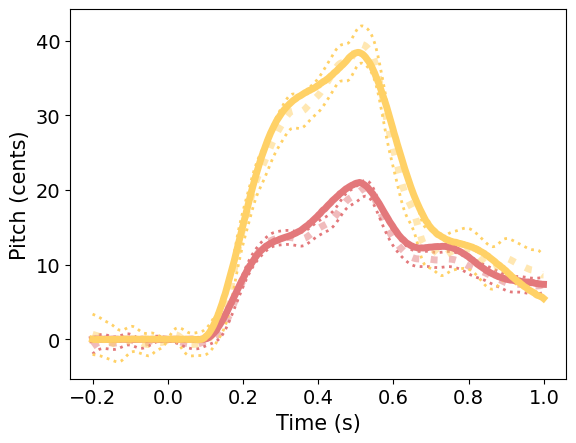

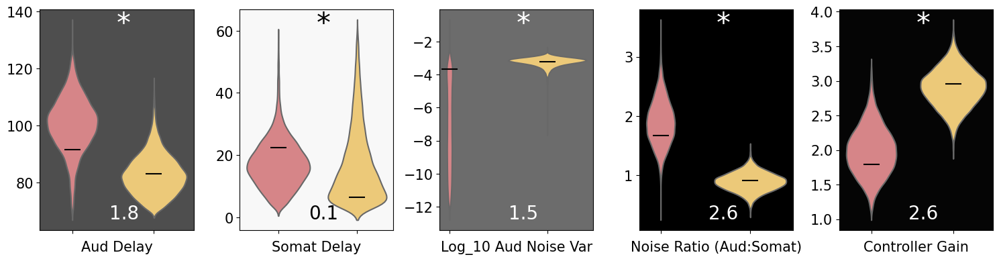

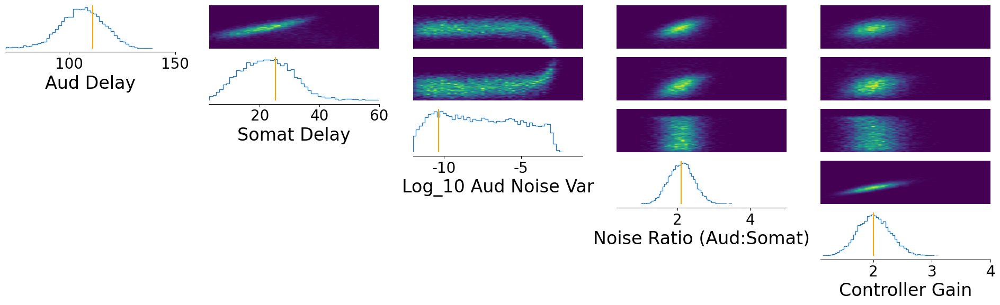

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.5714, 13.3669, -3.1877,  0.9976,  2.8468])


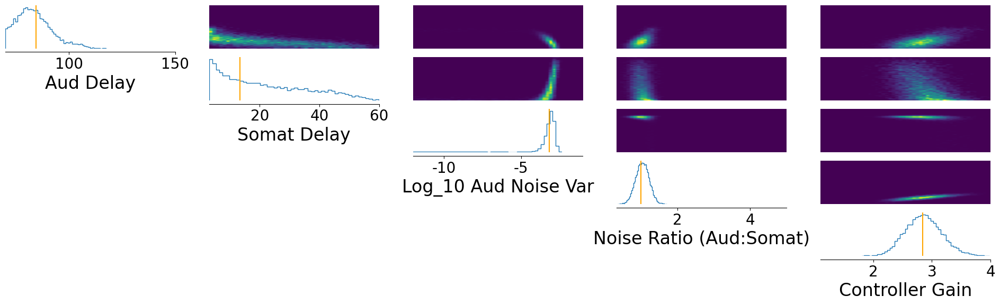

MSE: [0.3643517  2.69539805]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([116.4736,  26.7957,  -9.0271,   2.2326,   2.2118])


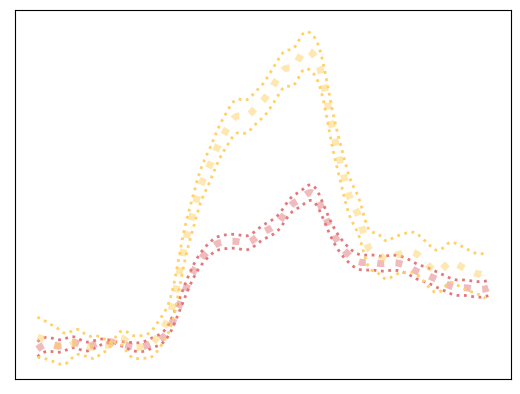

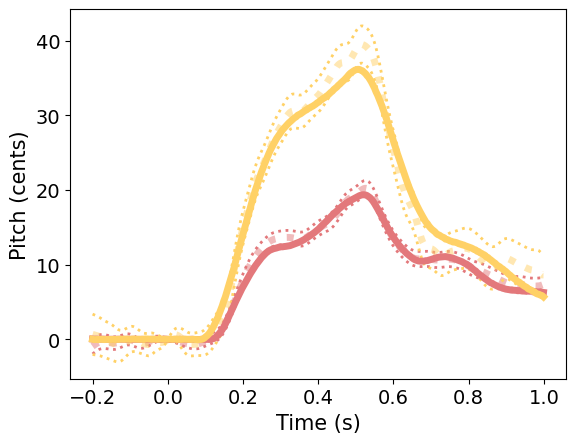

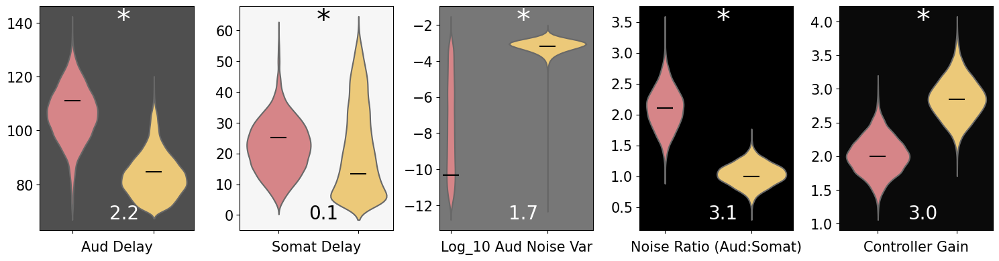

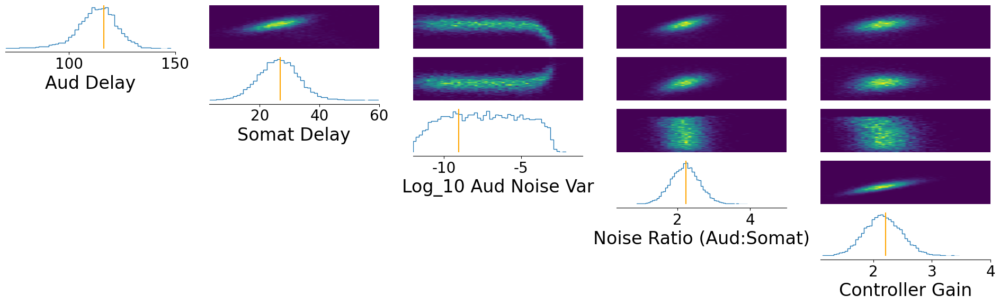

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.1767, 13.1798, -3.3211,  0.9866,  2.8964])


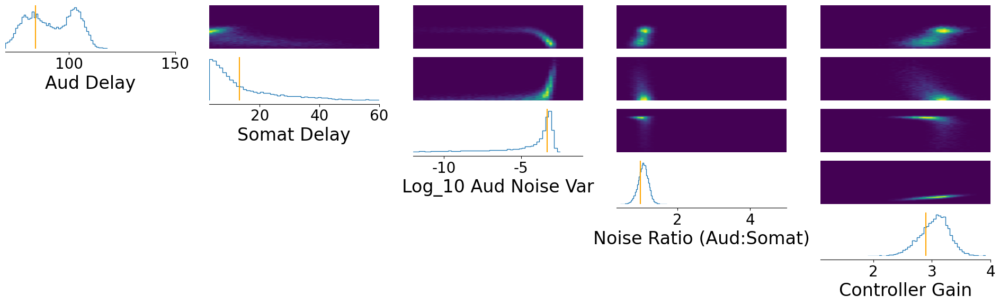

MSE: [0.47484485 2.46426274]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([113.1880,  21.4927,  -9.8619,   2.0340,   2.2492])


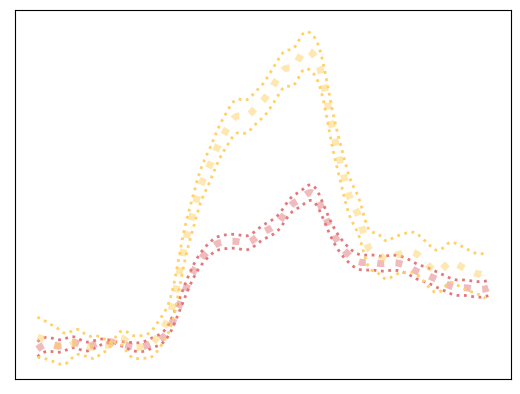

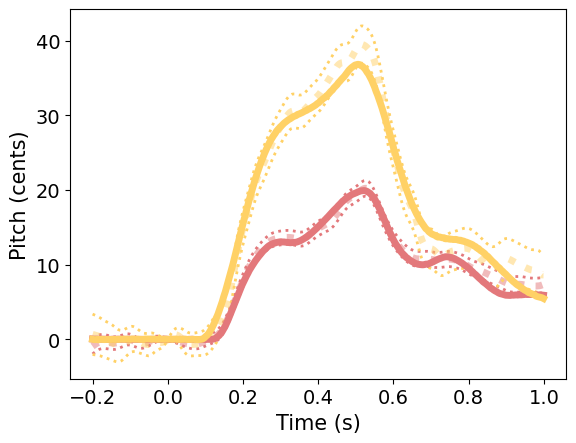

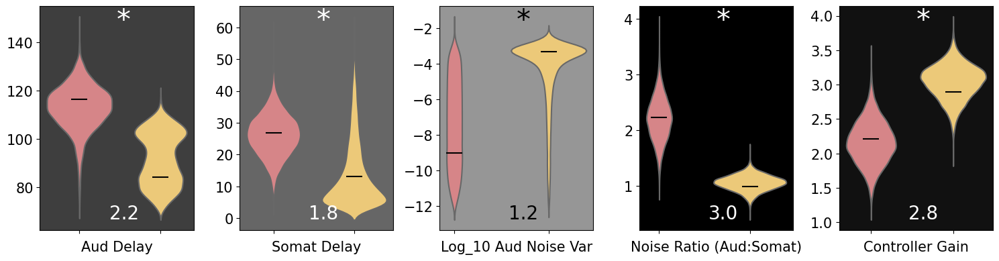

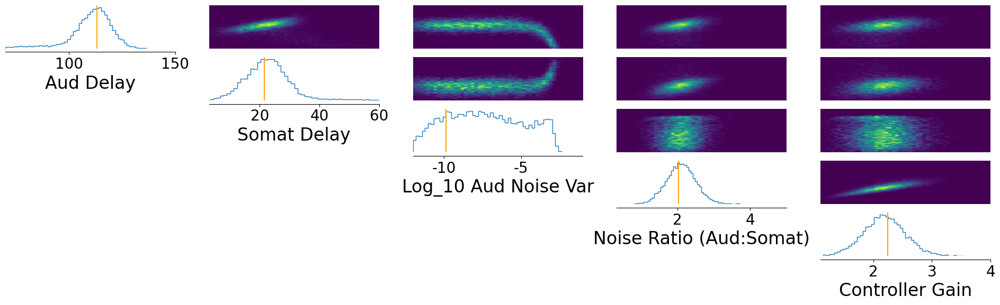

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([103.0487,   3.0274,  -6.8156,   1.2182,   3.3127])


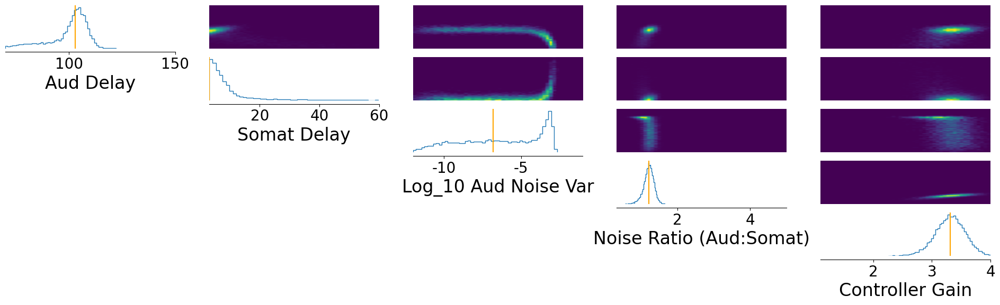

MSE: [0.78642591 8.39623765]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([106.3739,  21.1675,  -4.3901,   1.9201,   2.0492])


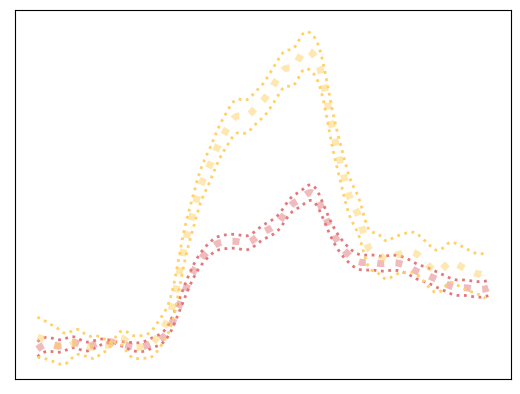

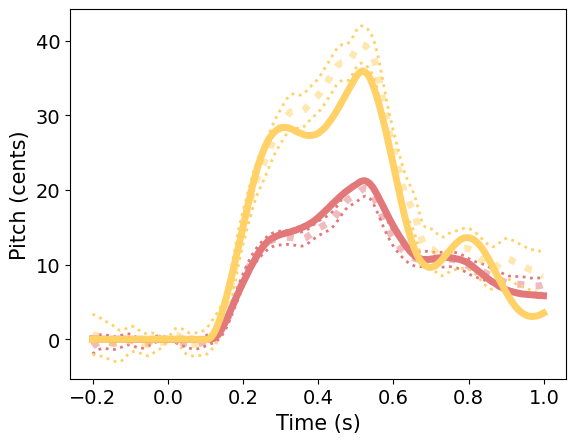

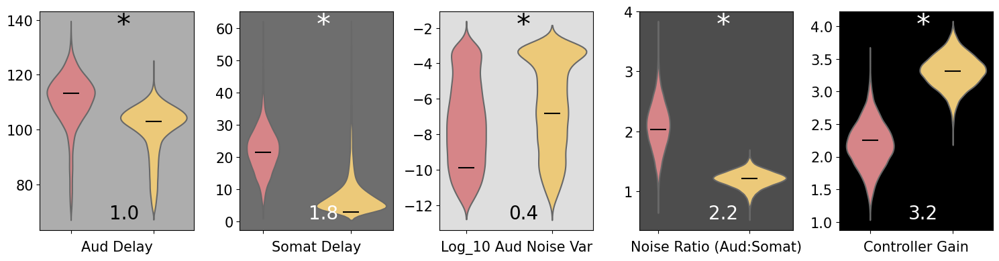

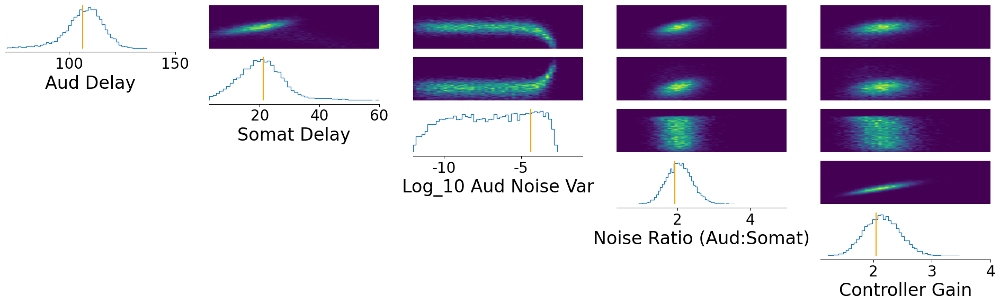

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.6078, 22.1026, -3.1169,  0.9176,  2.8467])


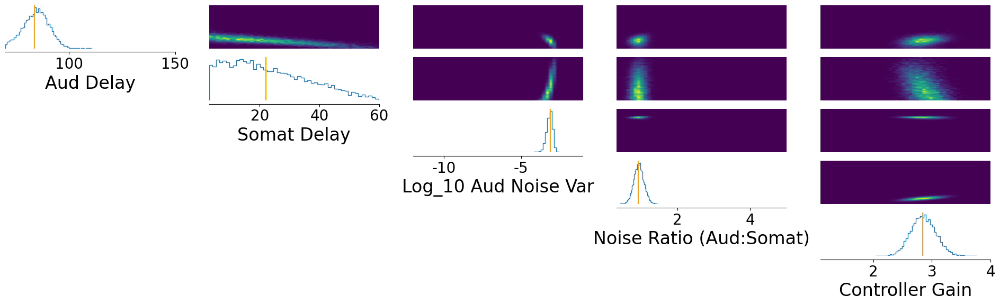

MSE: [0.56609552 2.24072414]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([108.4327,  22.3862,  -9.2589,   2.0223,   2.0201])


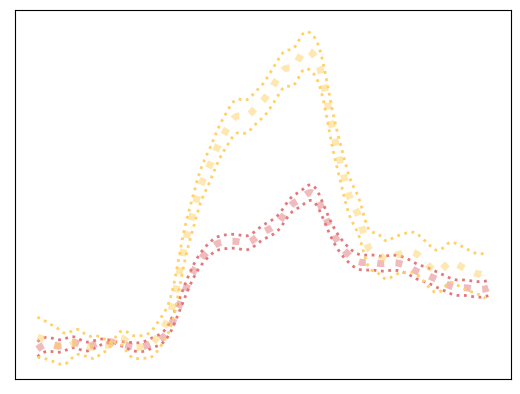

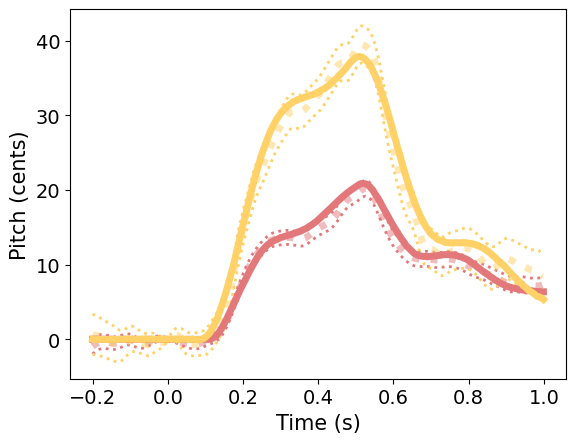

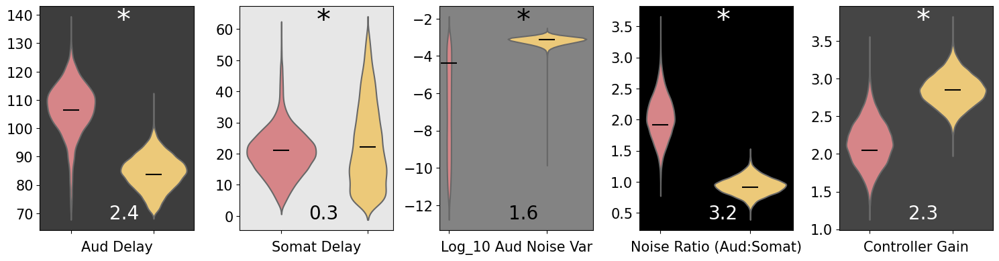

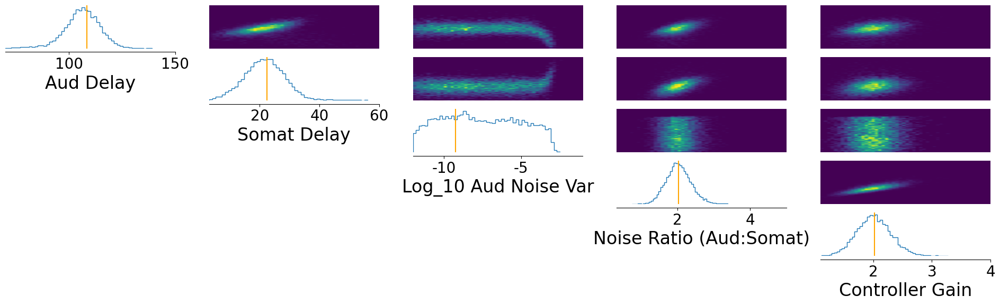

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([84.0567, 17.4989, -3.2397,  0.8974,  2.9131])


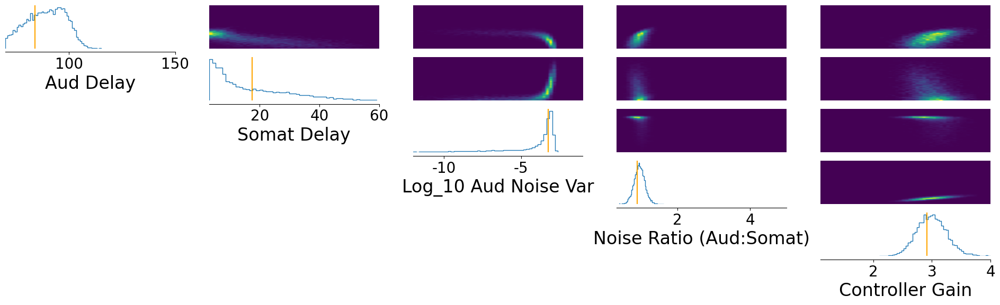

MSE: [0.33319733 2.6047626 ]


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([104.2661,  16.7591,  -6.4341,   2.1359,   2.2450])


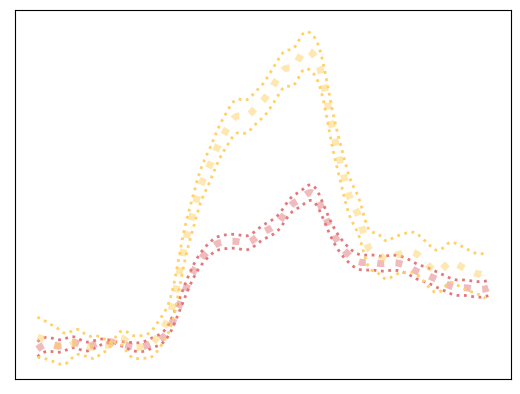

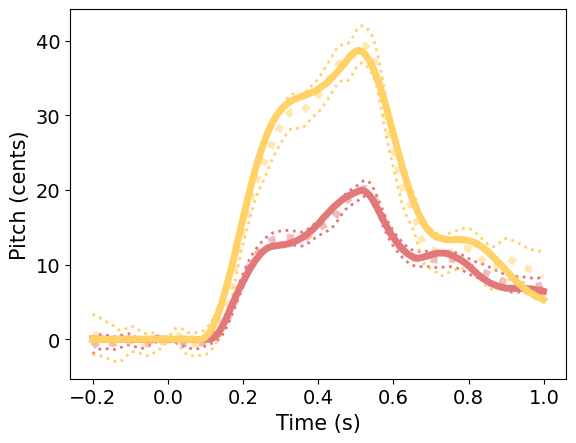

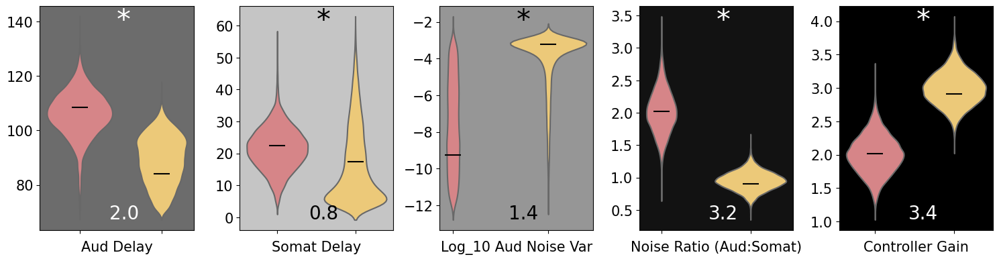

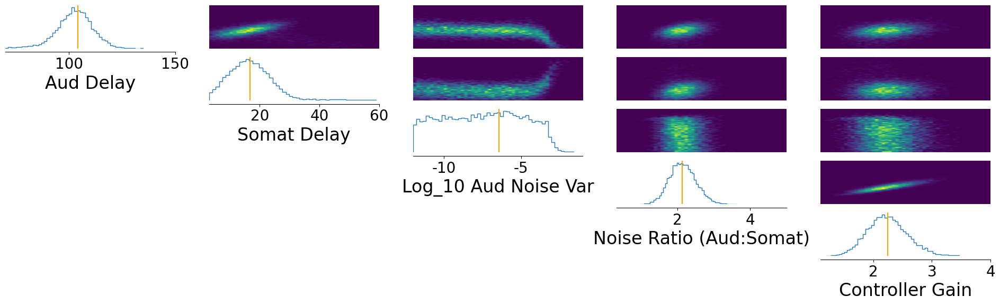

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

tensor([83.4330, 19.6852, -3.2110,  0.9171,  2.8954])


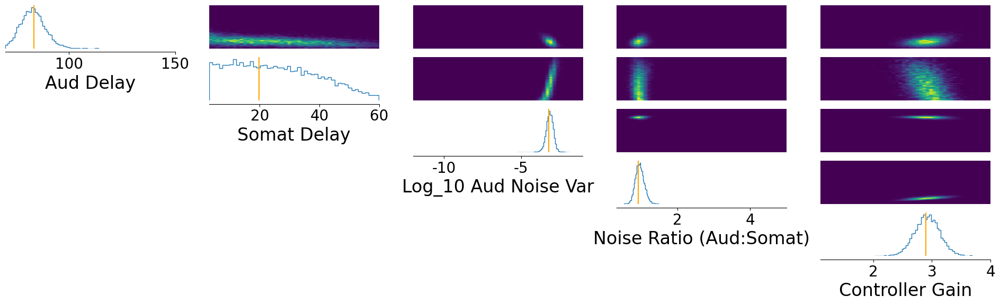

MSE: [0.56385464 2.40976318]


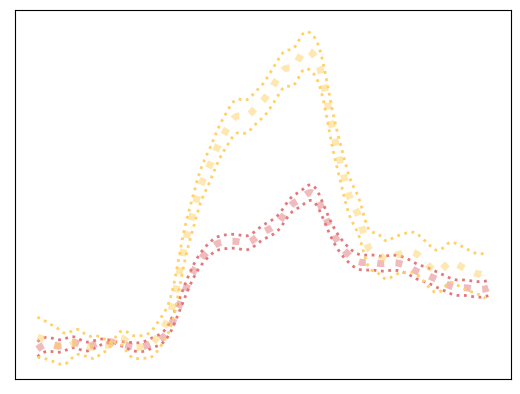

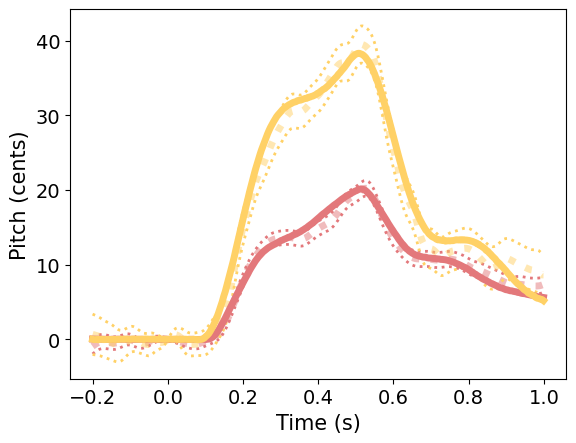

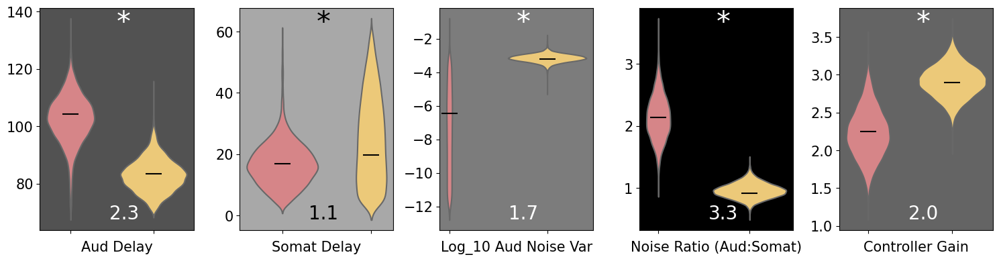

In [20]:
def simulator(parameter_set):
    training_noise_scale = 9
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

data_list,inferred_control_values_all, mse_vals[3,:,:] = run_sbi('training_noise_9',n_reps,prior_min_all,prior_max_all,all_labels,train=train)

<Figure size 200x300 with 0 Axes>

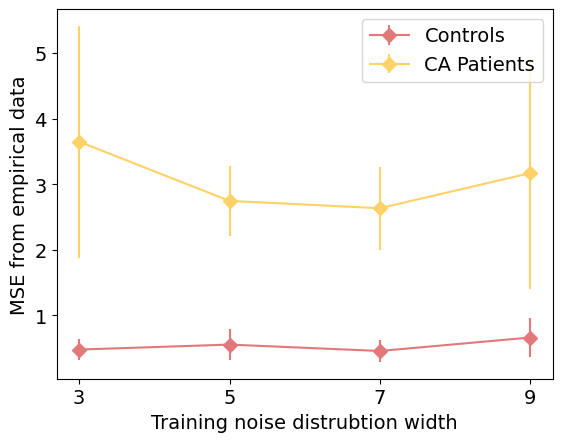

In [35]:
x = np.array([3,5,7,9])
bar_data = np.mean(mse_vals,axis=2)
bar_df = pd.DataFrame(bar_data,columns=['Controls','CA Patients'])
se_data = np.std(mse_vals,axis=2)
se_df = pd.DataFrame(se_data,columns = ['Controls','CA Patients'])
plt.figure(figsize=(2,3))
bar_df.plot(kind='line',yerr=se_df,rot=0,marker='D',markersize=7,color=[data_list[0].get('color'),data_list[1].get('color')])
plt.ylabel('MSE from empirical data',fontsize=14)
plt.xticks(ticks=range(len(x)),labels=x,fontsize=14)
plt.yticks(ticks=range(1,6),fontsize=14)
plt.xlabel('Training noise distrubtion width',fontsize=14)
plt.legend(fontsize=14)
plt.show()